# Comprehensive Model Diagnostics and Error Analysis

This notebook provides comprehensive diagnostic analysis and advanced visualization for mass spectrometry prediction models, combining core diagnostics with publication-style visualizations.

## Overview

### Core Analysis Components:

#### 1. Residual Analysis
- **Distribution Analysis**: Normality tests, Q-Q plots, and histogram analysis
- **Heteroscedasticity Testing**: Variance patterns across prediction ranges
- **Systematic Error Detection**: Identification of bias and model deficiencies

#### 2. Spectral Similarity Analysis
- **Comprehensive Similarity Metrics**: Cosine similarity, WDP scores, peak-level accuracy
- **Model Performance Ranking**: Statistical comparison and confidence intervals
- **Distribution Analysis**: Performance patterns across the test set

#### 3. Performance by m/z Range
- **Crossover Analysis**: Identifying where different models excel
- **Training Signal Distribution**: Understanding data density effects
- **Model Specialization**: Regions of superior/inferior performance

#### 4. Ensemble Weight Analysis (Multi-pane)
- **Weight Distribution**: How models are weighted across m/z ranges
- **Model Complementarity**: Understanding synergistic effects
- **Optimization Insights**: Why certain weights are chosen

#### 5. Intensity-Dependent Analysis
- **Error by Intensity Level**: Performance on weak vs strong peaks
- **Dynamic Range Assessment**: Model capability across intensity scales
- **Peak Detection Patterns**: Systematic under/over-prediction

### Advanced Visualization Components:

#### 6. Advanced Spectrum Visualization
- **Publication-Style Plots**: Professional experimental vs predicted comparison
- **Molecular Structure Integration**: Automated structure display with molecular properties
- **Smart m/z Focusing**: Automatic zoom to peak regions for clarity

#### 7. Multi-Model Comparison
- **Grid Visualizations**: Compact comparison layouts for all 8 models
- **Performance Sampling**: Best, worst, diverse, and random examples
- **Ensemble vs Individual**: Direct comparison of ensemble benefits

#### 8. Interactive Diagnostic Insights
- **Failure Mode Analysis**: Systematic error pattern identification
- **Chemical Space Analysis**: Molecular property correlation with performance
- **Model Specialization**: Understanding complementary strengths

#### 9. Final Recommendations
- **Model Selection Guidance**: Data-driven deployment recommendations
- **Quality Control Thresholds**: Performance benchmarks for production
- **Future Improvement Strategies**: Targeted enhancement opportunities

## Mathematical Foundation

### Residual Analysis
Residuals: $r_i = y_i - \hat{y}_i$

Standardized residuals: $r_i^* = \frac{r_i}{\hat{\sigma}\sqrt{1-h_{ii}}}$

### Heteroscedasticity Test (Breusch-Pagan)
Test statistic: $LM = nR^2$ where $R^2$ is from regressing $r_i^2$ on predictors

### Crossover Point Detection
Performance difference: $\Delta_{ij}(m/z) = P_i(m/z) - P_j(m/z)$

Crossover: $m/z^* : \Delta_{ij}(m/z^*) = 0$

### Spectral Similarity Metrics

**Cosine Similarity:**
$$\text{cos\_sim}(y, \hat{y}) = \frac{y \cdot \hat{y}}{||y||_2 \cdot ||\hat{y}||_2}$$

**Weighted Dot Product:**
$$\text{WDP}(y, \hat{y}) = \frac{\sum_{i} w_i \cdot y_i \cdot \hat{y}_i}{\sum_{i} w_i \cdot y_i^2}$$

where $w_i$ are intensity-dependent weights.

### Peak Detection Accuracy
$$\text{Peak\_Accuracy} = \frac{|\text{True Peaks} \cap \text{Predicted Peaks}|}{|\text{True Peaks} \cup \text{Predicted Peaks}|}$$

## Models Evaluated

### Individual Models (6):
1. **Random Forest**: Non-linear feature interactions with bootstrap aggregation
2. **K-Nearest Neighbors**: Optimized with Hamming distance metric
3. **ModularNet**: Attention-based module fusion neural network
4. **HierarchicalPredictionNet**: Two-stage presence and intensity prediction
5. **SparseGatedNet**: Specialized for extreme sparsity (74.4% zeros)
6. **RegionalExpertNet**: Multiple experts for different m/z regions

### Ensemble Models (2):
7. **Simple Weighted Ensemble**: Global weight optimization
8. **Bin-by-bin Ensemble**: Adaptive per-bin weight optimization

## 1. Environment Setup

Import all required libraries and configure the environment for comprehensive diagnostic analysis.

In [1]:
# Standard library imports
import os
import json
import pickle
import warnings
import logging
import io
import random
from typing import Dict, Any, Tuple, List, Optional, Union
from dataclasses import dataclass
import multiprocessing

# Data science imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
import seaborn as sns
from tqdm import tqdm
from PIL import Image

# Scientific computing
from scipy import stats
from scipy.spatial.distance import cosine, euclidean, cityblock
from scipy.interpolate import UnivariateSpline
from scipy.signal import find_peaks, savgol_filter
from scipy.ndimage import uniform_filter1d
import statsmodels.api as sm
from statsmodels.stats.diagnostic import het_breuschpagan
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# Machine learning imports
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

# Deep learning imports
import torch
import torch.nn as nn
import torch.nn.functional as F

# Chemistry imports
try:
    from rdkit import Chem
    from rdkit.Chem import Descriptors
    from rdkit.Chem.Draw import rdMolDraw2D
    RDKIT_AVAILABLE = True
    print("RDKit available for molecular structure visualization")
except ImportError:
    RDKIT_AVAILABLE = False
    print("Warning: RDKit not available. Molecular structure features will be limited.")

# Configure warnings and logging
warnings.filterwarnings('ignore')
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# Set random seeds for reproducibility
SEED = 42
np.random.seed(SEED)
random.seed(SEED)
torch.manual_seed(SEED)

# Parallel processing configuration
N_JOBS = min(multiprocessing.cpu_count() - 1, 16)
print(f"Using {N_JOBS} cores for parallel processing")

# Check GPU availability
if torch.cuda.is_available():
    print(f"CUDA available: {torch.cuda.get_device_name(0)}")
elif torch.backends.mps.is_available():
    print("MPS (Apple Silicon) available")
else:
    print("Using CPU for PyTorch operations")

# Set plot style for publication-quality figures
plt.rcParams.update({
    'font.size': 12,
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'axes.linewidth': 1.2,
    'axes.spines.top': False,
    'axes.spines.right': False,
    'xtick.major.size': 6,
    'xtick.minor.size': 3,
    'ytick.major.size': 6,
    'ytick.minor.size': 3,
    'legend.frameon': False,
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'savefig.bbox': 'tight',
    'figure.facecolor': 'white'
})

# Color palette for all 8 models
MODEL_COLORS = {
    'Random Forest': '#27ae60',
    'KNN': '#e74c3c',
    'ModularNet': '#8e44ad',
    'HierarchicalPredictionNet': '#16a085',
    'SparseGatedNet': '#d35400',
    'RegionalExpertNet': '#2c3e50',
    'Simple Weighted Ensemble': '#f39c12',
    'Bin-by-bin Ensemble': '#3498db'
}

print("Environment setup complete")

RDKit available for molecular structure visualization
Using 15 cores for parallel processing
MPS (Apple Silicon) available
Environment setup complete


## 2. Diagnostic Configuration

Central configuration for all diagnostic analysis parameters.

In [2]:
# Unified diagnostic configuration
DIAG_CONFIG = {
    'paths': {
        'models_dir': '../models',
        'results_dir': '../data/results',
        'figures_dir': '../figures/diagnostics',
        'input_type': 'hpj'
    },
    'analysis': {
        'mz_window': 50,  # Window size for m/z range analysis
        'mz_ranges': [(0, 100), (100, 200), (200, 300), (300, 400), (400, 500), (500, 1000)],
        'intensity_percentiles': [10, 25, 50, 75, 90],  # For intensity stratification
        'min_peaks_per_range': 10,  # Minimum peaks for reliable statistics
        'smoothing_window': 50  # For ensemble weight smoothing
    },
    'residual': {
        'n_bins': 50,  # Number of bins for residual histograms
        'alpha': 0.05,  # Significance level for statistical tests
        'outlier_threshold': 3  # Standard deviations for outlier detection
    },
    'visualization': {
        'n_examples': 6,  # Number of example spectra
        'example_selection': 'diverse',  # 'random', 'best', 'worst', 'diverse'
        'max_mz_display': 500,  # Maximum m/z for spectrum visualization
        'peak_annotation_threshold': 0.1,  # Minimum intensity for peak annotation
        'figure_format': 'png'
    },
    'crossover': {
        'performance_metric': 'cosine_similarity',  # Metric for crossover analysis
        'smoothing_degree': 3,  # Spline smoothing degree
        'min_difference': 0.01  # Minimum performance difference to be meaningful
    },
    'evaluation': {
        'peak_threshold': 0.01,
        'transform_sqrt': True
    }
}

# Create directories
os.makedirs(DIAG_CONFIG['paths']['figures_dir'], exist_ok=True)
print(f"Diagnostic figures will be saved to: {DIAG_CONFIG['paths']['figures_dir']}")

Diagnostic figures will be saved to: ../figures/diagnostics


## 3. ModularNet Architecture Definition

Define the ModularNet architecture to enable proper model loading from pickle files.

In [3]:
class ModularNet(nn.Module):
    """ModularNet architecture for mass spectrometry prediction."""
    
    def __init__(self, input_dim, output_dim, config):
        super().__init__()
        
        num_modules = config['num_modules']
        module_dims = config['module_dims']
        fusion_method = config['fusion_method']
        
        # Global feature extractor
        self.global_encoder = nn.Sequential(
            nn.Linear(input_dim, module_dims[0]),
            nn.BatchNorm1d(module_dims[0]),
            nn.ReLU(),
            nn.Dropout(0.1)
        )
        
        # Specialized modules
        self.specialized_modules = nn.ModuleList()
        
        for i in range(num_modules):
            module_layers = []
            dims = [input_dim] + module_dims
            
            for j in range(len(module_dims)):
                module_layers.extend([
                    nn.Linear(dims[j], dims[j+1]),
                    nn.BatchNorm1d(dims[j+1]),
                    nn.ReLU(),
                    nn.Dropout(0.1)
                ])
            
            module_layers.append(nn.Linear(module_dims[-1], output_dim))
            module_layers.append(nn.ReLU())
            
            self.specialized_modules.append(nn.Sequential(*module_layers))
        
        # Fusion mechanism
        if fusion_method == 'attention':
            self.fusion_attention = nn.Sequential(
                nn.Linear(module_dims[0], num_modules),
                nn.Softmax(dim=1)
            )
        else:
            # Simple averaging
            self.fusion_weights = nn.Parameter(torch.ones(num_modules) / num_modules)
    
    def forward(self, x):
        # Global encoding
        global_features = self.global_encoder(x)
        
        # Get predictions from each module
        module_outputs = []
        for module in self.specialized_modules:
            output = module(x)
            module_outputs.append(output)
        
        module_outputs = torch.stack(module_outputs, dim=1)  # [batch, num_modules, output_dim]
        
        # Fusion
        if hasattr(self, 'fusion_attention'):
            # Attention-based fusion
            attention_weights = self.fusion_attention(global_features)  # [batch, num_modules]
            attention_weights = attention_weights.unsqueeze(2)  # [batch, num_modules, 1]
            
            fused_output = (module_outputs * attention_weights).sum(dim=1)
        else:
            # Weighted average
            weights = F.softmax(self.fusion_weights, dim=0)
            weights = weights.view(1, -1, 1)  # [1, num_modules, 1]
            
            fused_output = (module_outputs * weights).sum(dim=1)
        
        return fused_output

print("ModularNet architecture defined")

ModularNet architecture defined


## 4. Data Loading and Preparation

Unified data loading for all diagnostic analyses from training pipeline outputs.

In [4]:
class DiagnosticDataLoader:
    """Unified data loader for diagnostic analysis from model prediction files."""
    
    def __init__(self, config: Dict[str, Any]):
        self.config = config
        self.predictions = {}
        self.test_data = {}
        self.ensemble_data = None
        
    def load_evaluation_results(self) -> Dict[str, np.ndarray]:
        """Load predictions from unified model prediction files."""
        models_dir = self.config['paths']['models_dir']
        
        # Load all model predictions from unified file
        all_predictions_path = os.path.join(models_dir, 'all_model_predictions.pkl')
        
        if os.path.exists(all_predictions_path):
            try:
                with open(all_predictions_path, 'rb') as f:
                    predictions_data = pickle.load(f)
                
                # Extract predictions
                self.predictions = predictions_data['predictions']
                self.test_data['y_test'] = predictions_data['y_true']
                self.test_data['test_smiles'] = predictions_data.get('test_smiles', [])
                self.test_data['X_test'] = predictions_data.get('X_test', None)
                self.test_data['scaler'] = predictions_data.get('scaler', None)
                
                logger.info(f"Loaded predictions for {len(self.predictions)} models")
                logger.info(f"Models: {list(self.predictions.keys())}")
                
            except Exception as e:
                logger.error(f"Could not load all_model_predictions.pkl: {e}")
                raise
        else:
            raise FileNotFoundError(f"Predictions file not found: {all_predictions_path}")
        
        # Load ensemble results separately for weight analysis
        ensemble_path = os.path.join(models_dir, 'ensemble_results.pkl')
        if os.path.exists(ensemble_path):
            try:
                with open(ensemble_path, 'rb') as f:
                    self.ensemble_data = pickle.load(f)
                
                # Add ensemble predictions if not already in main predictions
                if 'simple_weighted' in self.ensemble_data:
                    if 'Simple Weighted Ensemble' not in self.predictions:
                        self.predictions['Simple Weighted Ensemble'] = self.ensemble_data['simple_weighted']['predictions']
                
                if 'bin_by_bin' in self.ensemble_data:
                    if 'Bin-by-bin Ensemble' not in self.predictions:
                        self.predictions['Bin-by-bin Ensemble'] = self.ensemble_data['bin_by_bin']['predictions']
                
                logger.info("Loaded ensemble results for weight analysis")
                
            except Exception as e:
                logger.warning(f"Could not load ensemble results: {e}")
                logger.info("Ensemble weight analysis will be skipped")
        
        return self.predictions
    
    def prepare_diagnostic_data(self) -> Dict[str, Any]:
        """Prepare all data for diagnostic analysis."""
        # Load data
        self.load_evaluation_results()
        
        # Ensure we have some data
        if not self.predictions:
            raise ValueError("No prediction data could be loaded. Please ensure model results are available.")
        
        if 'y_test' not in self.test_data:
            raise ValueError("No test data could be loaded. Please ensure test data is available.")
        
        # Ensure non-negative predictions
        for model_name in self.predictions:
            self.predictions[model_name] = np.maximum(self.predictions[model_name], 0)
        
        # Calculate residuals
        residuals = {}
        for model_name, pred in self.predictions.items():
            residuals[model_name] = pred - self.test_data['y_test']
        
        return {
            'predictions': self.predictions,
            'y_test': self.test_data['y_test'],
            'residuals': residuals,
            'test_smiles': self.test_data.get('test_smiles', []),
            'X_test': self.test_data.get('X_test', None),
            'ensemble_data': self.ensemble_data,
            'scaler': self.test_data.get('scaler', None)
        }

# Load diagnostic data
print("Loading data for diagnostic analysis...")
loader = DiagnosticDataLoader(DIAG_CONFIG)

try:
    diagnostic_data = loader.prepare_diagnostic_data()
    
    print(f"\nLoaded data summary:")
    print(f"- Models with predictions: {list(diagnostic_data['predictions'].keys())}")
    print(f"- Test set size: {len(diagnostic_data['y_test'])} samples")
    print(f"- Spectrum length: {diagnostic_data['y_test'].shape[1]} m/z bins")
    print(f"- SMILES available: {len([s for s in diagnostic_data['test_smiles'] if s and s != 'N/A'])} valid SMILES")
    print(f"- Ensemble data available: {diagnostic_data['ensemble_data'] is not None}")
    
except Exception as e:
    print(f"\nError loading diagnostic data: {e}")
    print("\nPlease ensure that the following files are available:")
    print("- all_model_predictions.pkl in ../models/")
    print("- ensemble_results.pkl in ../models/ (optional, for weight analysis)")
    raise

2025-08-17 10:01:54,839 - INFO - Loaded predictions for 6 models
2025-08-17 10:01:54,842 - INFO - Models: ['Random Forest', 'KNN', 'ModularNet', 'HierarchicalPredictionNet', 'SparseGatedNet', 'RegionalExpertNet']
2025-08-17 10:01:54,843 - INFO - Loaded ensemble results for weight analysis


Loading data for diagnostic analysis...

Loaded data summary:
- Models with predictions: ['Random Forest', 'KNN', 'ModularNet', 'HierarchicalPredictionNet', 'SparseGatedNet', 'RegionalExpertNet', 'Simple Weighted Ensemble', 'Bin-by-bin Ensemble']
- Test set size: 272 samples
- Spectrum length: 500 m/z bins
- SMILES available: 272 valid SMILES
- Ensemble data available: True


## 5. Residual Analysis

Comprehensive analysis of prediction residuals to understand model errors and identify systematic patterns.


Performing residual analysis...

Random Forest:
  Mean residual: -0.0008
  Std residual: 0.0802
  Skewness: -4.602
  Kurtosis: 40.760
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1809 (1.96%)


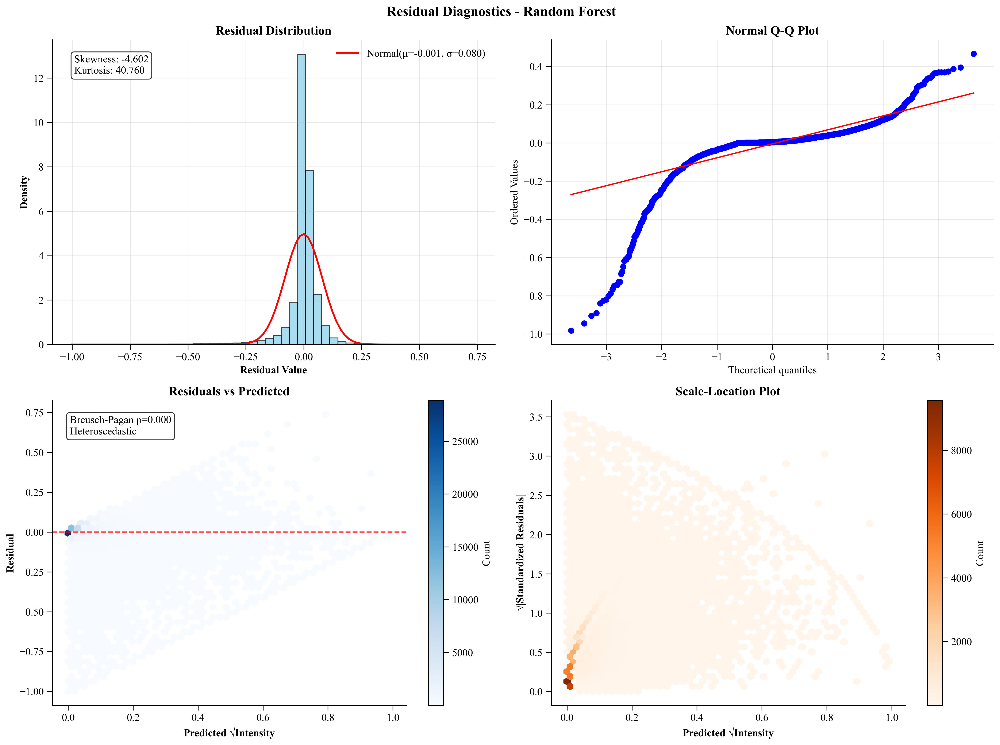


KNN:
  Mean residual: -0.0050
  Std residual: 0.1123
  Skewness: -2.496
  Kurtosis: 18.480
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1203 (2.17%)


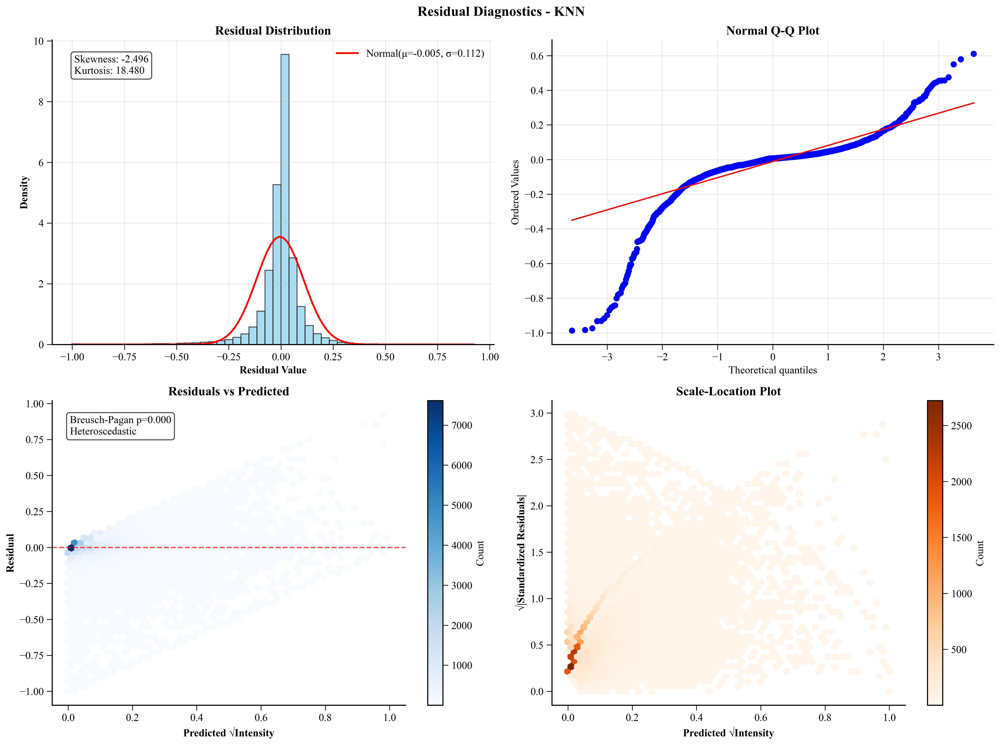


ModularNet:
  Mean residual: -0.0188
  Std residual: 0.1201
  Skewness: -1.984
  Kurtosis: 17.983
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 979 (2.16%)


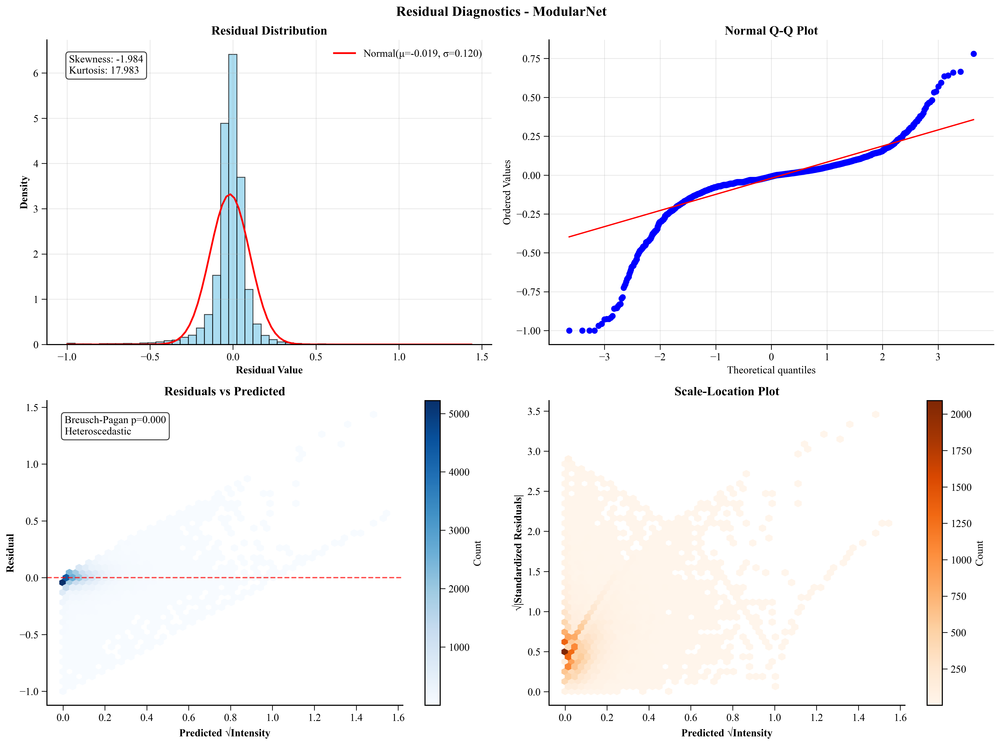


HierarchicalPredictionNet:
  Mean residual: -0.0045
  Std residual: 0.0873
  Skewness: -2.823
  Kurtosis: 37.591
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1823 (2.08%)


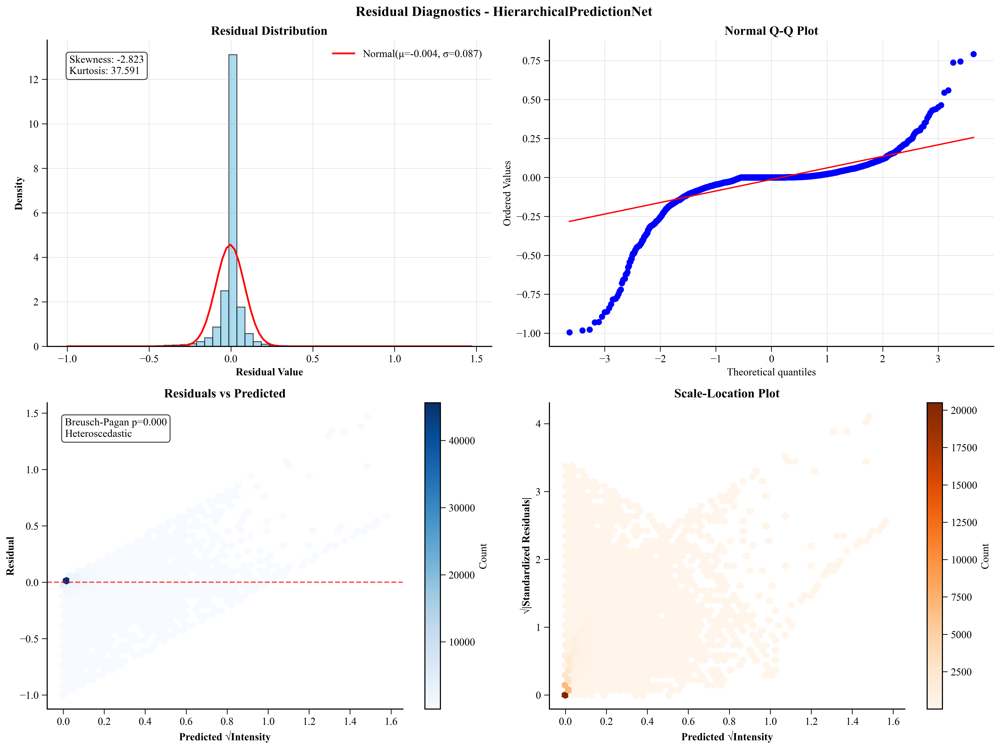


SparseGatedNet:
  Mean residual: -0.0150
  Std residual: 0.1112
  Skewness: -2.304
  Kurtosis: 21.736
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1136 (2.11%)


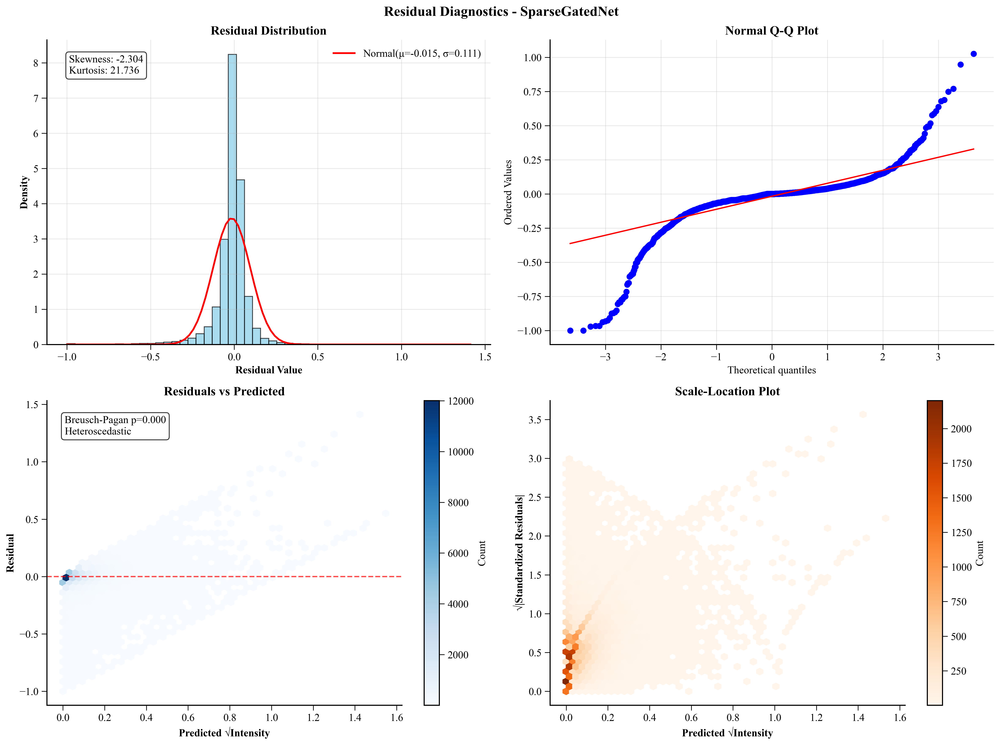


RegionalExpertNet:
  Mean residual: -0.0191
  Std residual: 0.1296
  Skewness: -1.466
  Kurtosis: 15.894
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 898 (2.12%)


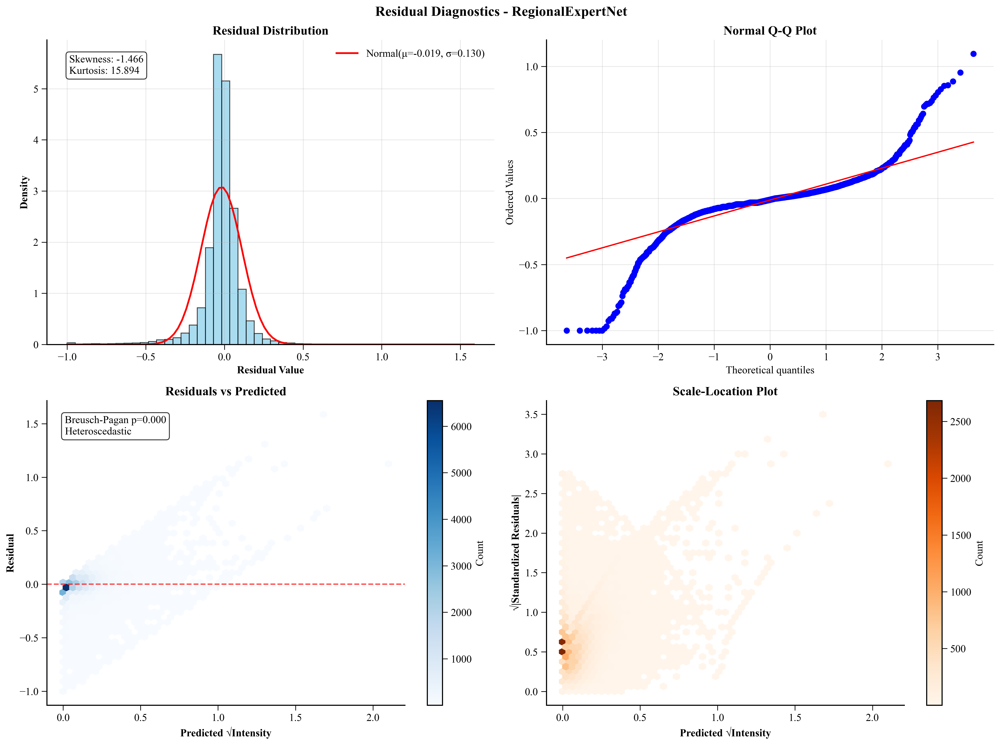


Simple Weighted Ensemble:
  Mean residual: -0.0041
  Std residual: 0.0743
  Skewness: -4.763
  Kurtosis: 49.633
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1984 (1.93%)


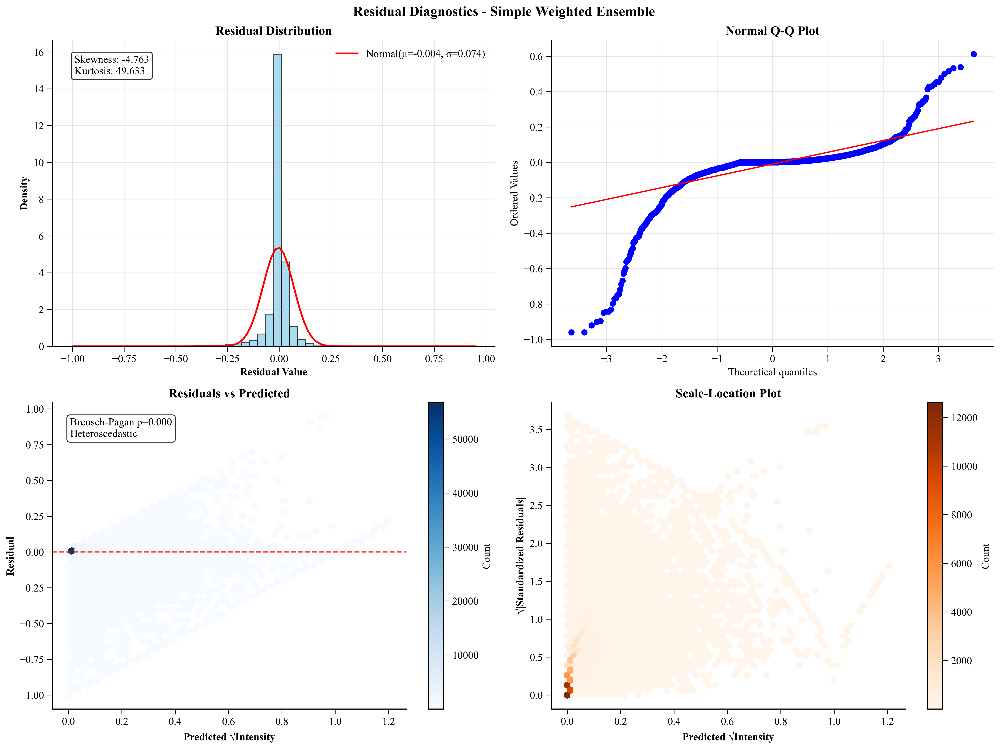


Bin-by-bin Ensemble:
  Mean residual: -0.0040
  Std residual: 0.0729
  Skewness: -4.943
  Kurtosis: 48.605
  Normality (Shapiro p-value): 0.0000 (Non-normal)
  Homoscedasticity (BP p-value): 0.0000 (Heteroscedastic)
  Outliers: 1940 (1.92%)


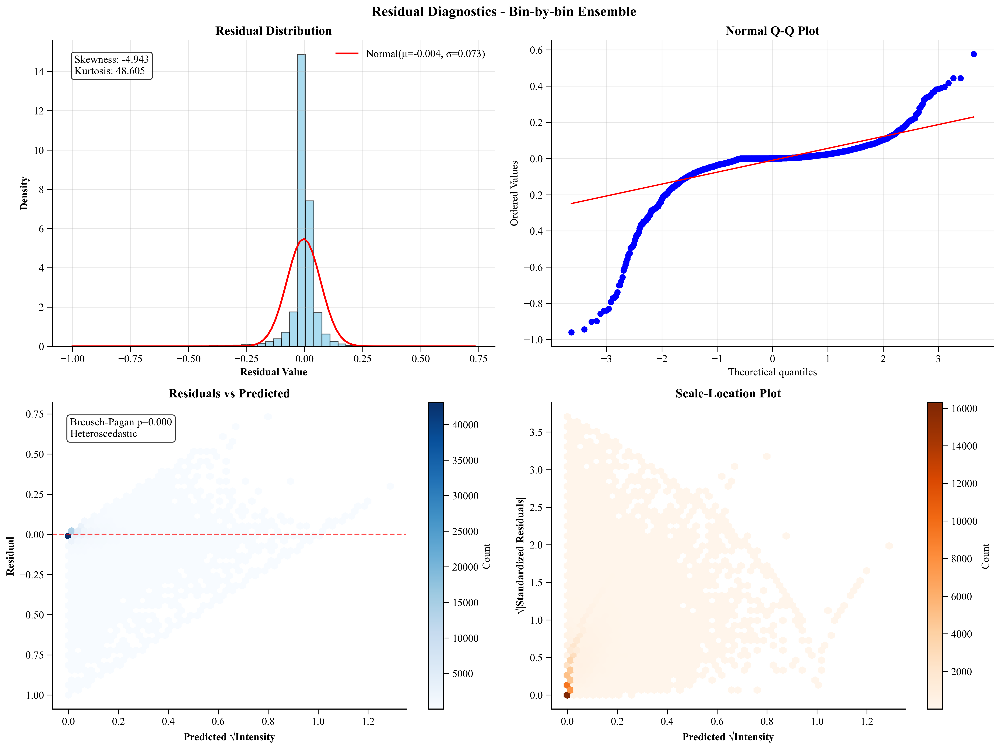

In [5]:
class ResidualAnalyzer:
    """Comprehensive residual analysis for model diagnostics"""
    
    def __init__(self, config: Dict[str, Any]):
        self.config = config
    
    def analyze_residuals(self, y_true: np.ndarray, y_pred: np.ndarray, 
                         model_name: str) -> Dict[str, Any]:
        """Perform comprehensive residual analysis"""
        # Calculate residuals
        residuals = y_pred - y_true
        residuals_flat = residuals.flatten()
        y_true_flat = y_true.flatten()
        y_pred_flat = y_pred.flatten()
        
        # Remove zeros for some analyses
        nonzero_mask = (y_true_flat > 0) | (y_pred_flat > 0)
        residuals_nonzero = residuals_flat[nonzero_mask]
        y_true_nonzero = y_true_flat[nonzero_mask]
        y_pred_nonzero = y_pred_flat[nonzero_mask]
        
        # Basic statistics
        stats_dict = {
            'mean': np.mean(residuals_nonzero),
            'std': np.std(residuals_nonzero),
            'median': np.median(residuals_nonzero),
            'mad': np.median(np.abs(residuals_nonzero - np.median(residuals_nonzero))),
            'skewness': stats.skew(residuals_nonzero),
            'kurtosis': stats.kurtosis(residuals_nonzero),
            'min': np.min(residuals_nonzero),
            'max': np.max(residuals_nonzero)
        }
        
        # Normality tests
        if len(residuals_nonzero) > 5000:
            # Use subset for Shapiro-Wilk test (computational limit)
            sample_idx = np.random.choice(len(residuals_nonzero), 5000, replace=False)
            shapiro_stat, shapiro_p = stats.shapiro(residuals_nonzero[sample_idx])
        else:
            shapiro_stat, shapiro_p = stats.shapiro(residuals_nonzero)
        
        stats_dict['shapiro_stat'] = shapiro_stat
        stats_dict['shapiro_p'] = shapiro_p
        stats_dict['is_normal'] = shapiro_p > self.config['residual']['alpha']
        
        # Heteroscedasticity test (Breusch-Pagan)
        try:
            # Prepare data for Breusch-Pagan test
            X = sm.add_constant(y_pred_nonzero)
            bp_stat, bp_p, _, _ = het_breuschpagan(residuals_nonzero, X)
            stats_dict['breusch_pagan_stat'] = bp_stat
            stats_dict['breusch_pagan_p'] = bp_p
            stats_dict['is_homoscedastic'] = bp_p > self.config['residual']['alpha']
        except:
            stats_dict['breusch_pagan_stat'] = np.nan
            stats_dict['breusch_pagan_p'] = np.nan
            stats_dict['is_homoscedastic'] = None
        
        # Outlier detection
        z_scores = np.abs((residuals_nonzero - stats_dict['mean']) / stats_dict['std'])
        outlier_mask = z_scores > self.config['residual']['outlier_threshold']
        stats_dict['n_outliers'] = np.sum(outlier_mask)
        stats_dict['outlier_percentage'] = np.sum(outlier_mask) / len(residuals_nonzero) * 100
        
        # Store arrays for plotting
        stats_dict['residuals'] = residuals_nonzero
        stats_dict['y_true'] = y_true_nonzero
        stats_dict['y_pred'] = y_pred_nonzero
        stats_dict['z_scores'] = z_scores
        stats_dict['outlier_mask'] = outlier_mask
        
        return stats_dict
    
    def plot_residual_diagnostics(self, residual_stats: Dict[str, Any], 
                                 model_name: str) -> None:
        """Create comprehensive residual diagnostic plots in 2x2 panel"""
        residuals = residual_stats['residuals']
        y_pred = residual_stats['y_pred']
        
        # Create 2x2 subplot figure
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'Residual Diagnostics - {model_name}', 
                     fontsize=16, fontweight='bold')
        
        # 1. Residual histogram with normal overlay (top left)
        ax1 = axes[0, 0]
        ax1.hist(residuals, bins=self.config['residual']['n_bins'], 
                density=True, alpha=0.7, color='skyblue', edgecolor='black')
        
        # Overlay normal distribution
        x = np.linspace(residuals.min(), residuals.max(), 100)
        ax1.plot(x, stats.norm.pdf(x, residual_stats['mean'], residual_stats['std']), 
                'r-', linewidth=2, label=f'Normal(μ={residual_stats["mean"]:.3f}, σ={residual_stats["std"]:.3f})')
        ax1.set_xlabel('Residual Value', fontweight='bold')
        ax1.set_ylabel('Density', fontweight='bold')
        ax1.set_title('Residual Distribution', fontweight='bold')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # Add statistics text
        stats_text = f"Skewness: {residual_stats['skewness']:.3f}\nKurtosis: {residual_stats['kurtosis']:.3f}"
        ax1.text(0.05, 0.95, stats_text, transform=ax1.transAxes, 
                verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # 2. Q-Q plot (top right)
        ax2 = axes[0, 1]
        stats.probplot(residuals[:min(5000, len(residuals))], dist="norm", plot=ax2)
        ax2.set_title('Normal Q-Q Plot', fontweight='bold')
        ax2.grid(True, alpha=0.3)
        
        # 3. Residuals vs Predicted (bottom left)
        ax3 = axes[1, 0]
        scatter = ax3.hexbin(y_pred, residuals, gridsize=50, cmap='Blues', mincnt=1)
        ax3.axhline(y=0, color='red', linestyle='--', alpha=0.7)
        ax3.set_xlabel('Predicted √Intensity', fontweight='bold')
        ax3.set_ylabel('Residual', fontweight='bold')
        ax3.set_title('Residuals vs Predicted', fontweight='bold')
        plt.colorbar(scatter, ax=ax3, label='Count')
        
        # Add heteroscedasticity test result
        if residual_stats['is_homoscedastic'] is not None:
            het_text = f"Breusch-Pagan p={residual_stats['breusch_pagan_p']:.3f}\n"
            het_text += "Homoscedastic" if residual_stats['is_homoscedastic'] else "Heteroscedastic"
            ax3.text(0.05, 0.95, het_text, transform=ax3.transAxes, 
                    verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # 4. Scale-Location plot (bottom right)
        ax4 = axes[1, 1]
        standardized_residuals = residuals / residual_stats['std']
        scatter2 = ax4.hexbin(y_pred, np.sqrt(np.abs(standardized_residuals)), 
                             gridsize=50, cmap='Oranges', mincnt=1)
        ax4.set_xlabel('Predicted √Intensity', fontweight='bold')
        ax4.set_ylabel('√|Standardized Residuals|', fontweight='bold')
        ax4.set_title('Scale-Location Plot', fontweight='bold')
        plt.colorbar(scatter2, ax=ax4, label='Count')
        
        plt.tight_layout()
        save_path = os.path.join(self.config['paths']['figures_dir'], 
                                f'residual_diagnostics_{model_name.replace(" ", "_").lower()}.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()

# Perform residual analysis for each model
print("\nPerforming residual analysis...")
residual_analyzer = ResidualAnalyzer(DIAG_CONFIG)
residual_results = {}

for model_name in diagnostic_data['predictions'].keys():
    print(f"\n{model_name}:")
    
    # Analyze residuals
    residual_stats = residual_analyzer.analyze_residuals(
        diagnostic_data['y_test'],
        diagnostic_data['predictions'][model_name],
        model_name
    )
    residual_results[model_name] = residual_stats
    
    # Print summary
    print(f"  Mean residual: {residual_stats['mean']:.4f}")
    print(f"  Std residual: {residual_stats['std']:.4f}")
    print(f"  Skewness: {residual_stats['skewness']:.3f}")
    print(f"  Kurtosis: {residual_stats['kurtosis']:.3f}")
    print(f"  Normality (Shapiro p-value): {residual_stats['shapiro_p']:.4f} "
          f"({'Normal' if residual_stats['is_normal'] else 'Non-normal'})")
    print(f"  Homoscedasticity (BP p-value): {residual_stats['breusch_pagan_p']:.4f} "
          f"({'Homoscedastic' if residual_stats['is_homoscedastic'] else 'Heteroscedastic'})")
    print(f"  Outliers: {residual_stats['n_outliers']} ({residual_stats['outlier_percentage']:.2f}%)")
    
    # Create diagnostic plots
    residual_analyzer.plot_residual_diagnostics(residual_stats, model_name)

## 6. Spectral Similarity Analysis

Comprehensive analysis of model performance using multiple similarity metrics.

In [6]:
class SpectralSimilarityCalculator:
    """Calculate various spectral similarity metrics for model evaluation."""
    
    def __init__(self, transform_sqrt=True):
        self.transform_sqrt = transform_sqrt
    
    def cosine_similarity(self, y_true: np.ndarray, y_pred: np.ndarray) -> float:
        """Calculate cosine similarity between spectra."""
        if np.sum(y_true) == 0 and np.sum(y_pred) == 0:
            return 1.0
        elif np.sum(y_true) == 0 or np.sum(y_pred) == 0:
            return 0.0
        return 1 - cosine(y_true, y_pred)
    
    def weighted_dot_product(self, y_true: np.ndarray, y_pred: np.ndarray, eps: float = 1e-8) -> float:
        """Calculate weighted dot product (WDP) score."""
        # Use intensity-based weighting
        weights = y_true + eps  # Avoid division by zero
        numerator = np.sum(weights * y_true * y_pred)
        denominator = np.sum(weights * y_true * y_true) + eps
        return numerator / denominator
    
    def peak_accuracy(self, y_true: np.ndarray, y_pred: np.ndarray, threshold: float = 0.01) -> Dict[str, float]:
        """Calculate peak detection accuracy metrics."""
        true_peaks = set(np.where(y_true > threshold)[0])
        pred_peaks = set(np.where(y_pred > threshold)[0])
        
        if len(true_peaks) == 0 and len(pred_peaks) == 0:
            return {'precision': 1.0, 'recall': 1.0, 'f1': 1.0, 'jaccard': 1.0}
        
        intersection = true_peaks.intersection(pred_peaks)
        union = true_peaks.union(pred_peaks)
        
        precision = len(intersection) / len(pred_peaks) if len(pred_peaks) > 0 else 0.0
        recall = len(intersection) / len(true_peaks) if len(true_peaks) > 0 else 0.0
        f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0.0
        jaccard = len(intersection) / len(union) if len(union) > 0 else 0.0
        
        return {'precision': precision, 'recall': recall, 'f1': f1, 'jaccard': jaccard}
    
    def euclidean_distance(self, y_true: np.ndarray, y_pred: np.ndarray) -> float:
        """Calculate normalized Euclidean distance."""
        max_possible = np.sqrt(np.sum(y_true**2) + np.sum(y_pred**2))
        if max_possible == 0:
            return 0.0
        return euclidean(y_true, y_pred) / max_possible
    
    def spectral_angle(self, y_true: np.ndarray, y_pred: np.ndarray) -> float:
        """Calculate spectral angle similarity."""
        cos_sim = self.cosine_similarity(y_true, y_pred)
        cos_sim = np.clip(cos_sim, -1.0, 1.0)
        angle = np.arccos(cos_sim)
        return 1 - (angle / np.pi)

# Calculate comprehensive similarity metrics for all models
print("Calculating comprehensive similarity metrics for all models...")
calc = SpectralSimilarityCalculator(transform_sqrt=DIAG_CONFIG['evaluation']['transform_sqrt'])

# Store results for each model
similarity_results = {}
y_test = diagnostic_data['y_test']

for model_name, predictions in diagnostic_data['predictions'].items():
    print(f"\nAnalyzing {model_name}...")
    
    model_results = {
        'cosine_similarities': [],
        'wdp_scores': [],
        'peak_accuracies': [],
        'euclidean_distances': [],
        'spectral_angles': []
    }
    
    for i in tqdm(range(len(y_test)), desc=f"Processing {model_name}", leave=False):
        # Calculate all metrics for this sample
        cosine_sim = calc.cosine_similarity(y_test[i], predictions[i])
        wdp_score = calc.weighted_dot_product(y_test[i], predictions[i])
        peak_acc = calc.peak_accuracy(y_test[i], predictions[i])
        eucl_dist = calc.euclidean_distance(y_test[i], predictions[i])
        spectral_angle = calc.spectral_angle(y_test[i], predictions[i])
        
        model_results['cosine_similarities'].append(cosine_sim)
        model_results['wdp_scores'].append(wdp_score)
        model_results['peak_accuracies'].append(peak_acc)
        model_results['euclidean_distances'].append(eucl_dist)
        model_results['spectral_angles'].append(spectral_angle)
    
    # Convert to numpy arrays and calculate summary statistics
    model_results['cosine_similarities'] = np.array(model_results['cosine_similarities'])
    model_results['wdp_scores'] = np.array(model_results['wdp_scores'])
    model_results['euclidean_distances'] = np.array(model_results['euclidean_distances'])
    model_results['spectral_angles'] = np.array(model_results['spectral_angles'])
    
    # Extract peak accuracy metrics
    peak_precision = [acc['precision'] for acc in model_results['peak_accuracies']]
    peak_recall = [acc['recall'] for acc in model_results['peak_accuracies']]
    peak_f1 = [acc['f1'] for acc in model_results['peak_accuracies']]
    peak_jaccard = [acc['jaccard'] for acc in model_results['peak_accuracies']]
    
    model_results['peak_precision'] = np.array(peak_precision)
    model_results['peak_recall'] = np.array(peak_recall)
    model_results['peak_f1'] = np.array(peak_f1)
    model_results['peak_jaccard'] = np.array(peak_jaccard)
    
    # Summary statistics
    model_results['summary'] = {
        'mean_cosine': np.mean(model_results['cosine_similarities']),
        'std_cosine': np.std(model_results['cosine_similarities']),
        'median_cosine': np.median(model_results['cosine_similarities']),
        'mean_wdp': np.mean(model_results['wdp_scores']),
        'std_wdp': np.std(model_results['wdp_scores']),
        'mean_peak_f1': np.mean(model_results['peak_f1']),
        'std_peak_f1': np.std(model_results['peak_f1']),
        'mean_euclidean': np.mean(model_results['euclidean_distances']),
        'std_euclidean': np.std(model_results['euclidean_distances']),
        'mean_spectral_angle': np.mean(model_results['spectral_angles']),
        'percentile_5': np.percentile(model_results['cosine_similarities'], 5),
        'percentile_95': np.percentile(model_results['cosine_similarities'], 95)
    }
    
    similarity_results[model_name] = model_results
    
    # Print summary
    summary = model_results['summary']
    print(f"  Cosine Similarity: {summary['mean_cosine']:.4f} ± {summary['std_cosine']:.4f}")
    print(f"  WDP Score: {summary['mean_wdp']:.4f} ± {summary['std_wdp']:.4f}")
    print(f"  Peak F1 Score: {summary['mean_peak_f1']:.4f} ± {summary['std_peak_f1']:.4f}")
    print(f"  Spectral Angle: {summary['mean_spectral_angle']:.4f} ± {summary['std_euclidean']:.4f}")

print("\nSimilarity analysis complete!")

Calculating comprehensive similarity metrics for all models...

Analyzing Random Forest...


  Cosine Similarity: 0.7837 ± 0.1397
  WDP Score: 0.4948 ± 0.2316
  Peak F1 Score: 0.7057 ± 0.1481
  Spectral Angle: 0.7976 ± 0.1629

Analyzing KNN...


  Cosine Similarity: 0.7325 ± 0.1570
  WDP Score: 0.4838 ± 0.2276
  Peak F1 Score: 0.7529 ± 0.1220
  Spectral Angle: 0.7709 ± 0.1552

Analyzing ModularNet...


  Cosine Similarity: 0.7691 ± 0.1710
  WDP Score: 0.5861 ± 0.3333
  Peak F1 Score: 0.7798 ± 0.1059
  Spectral Angle: 0.7939 ± 0.1877

Analyzing HierarchicalPredictionNet...


  Cosine Similarity: 0.7770 ± 0.1660
  WDP Score: 0.6288 ± 0.3682
  Peak F1 Score: 0.7837 ± 0.1120
  Spectral Angle: 0.7976 ± 0.1795

Analyzing SparseGatedNet...


  Cosine Similarity: 0.7674 ± 0.1734
  WDP Score: 0.5714 ± 0.3247
  Peak F1 Score: 0.7707 ± 0.1088
  Spectral Angle: 0.7933 ± 0.1913

Analyzing RegionalExpertNet...


  Cosine Similarity: 0.7622 ± 0.1766
  WDP Score: 0.5818 ± 0.3252
  Peak F1 Score: 0.7664 ± 0.1195
  Spectral Angle: 0.7903 ± 0.1808

Analyzing Simple Weighted Ensemble...


  Cosine Similarity: 0.8037 ± 0.1455
  WDP Score: 0.5482 ± 0.2721
  Peak F1 Score: 0.7501 ± 0.1345
  Spectral Angle: 0.8107 ± 0.1780

Analyzing Bin-by-bin Ensemble...


  Cosine Similarity: 0.8164 ± 0.1357
  WDP Score: 0.5646 ± 0.2654
  Peak F1 Score: 0.7477 ± 0.1333
  Spectral Angle: 0.8167 ± 0.1712

Similarity analysis complete!


## 7. Performance by m/z Range Analysis

Analyze model performance across different m/z ranges to identify regions of strength and weakness.


Analyzing performance by m/z range...
  Calculating for Random Forest...
  Calculating for KNN...
  Calculating for ModularNet...
  Calculating for HierarchicalPredictionNet...
  Calculating for SparseGatedNet...
  Calculating for RegionalExpertNet...
  Calculating for Simple Weighted Ensemble...
  Calculating for Bin-by-bin Ensemble...

Found 252 crossover points:
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ KNN at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Forest ↔ ModularNet at m/z nan
  Random Fores

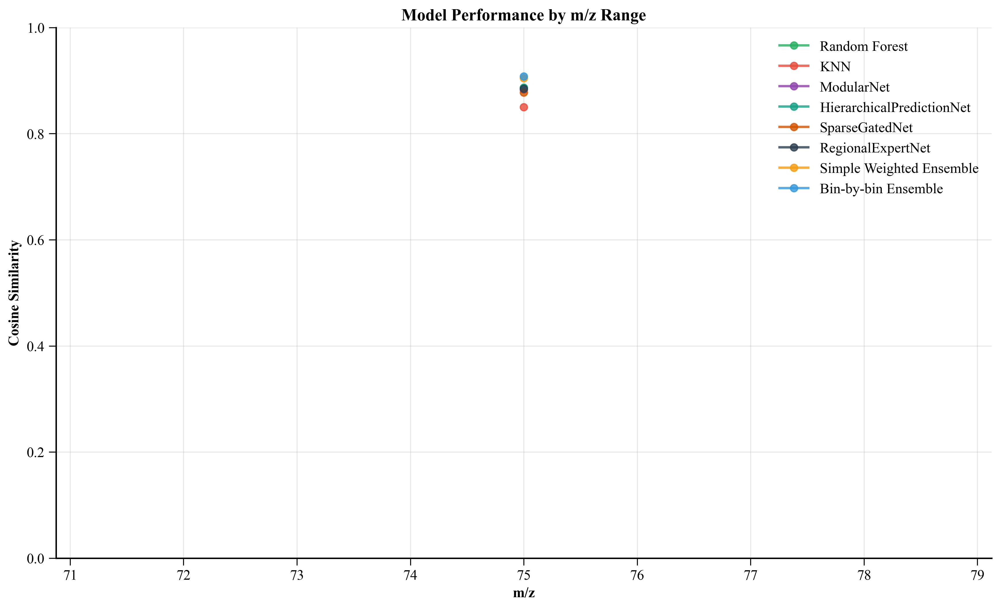

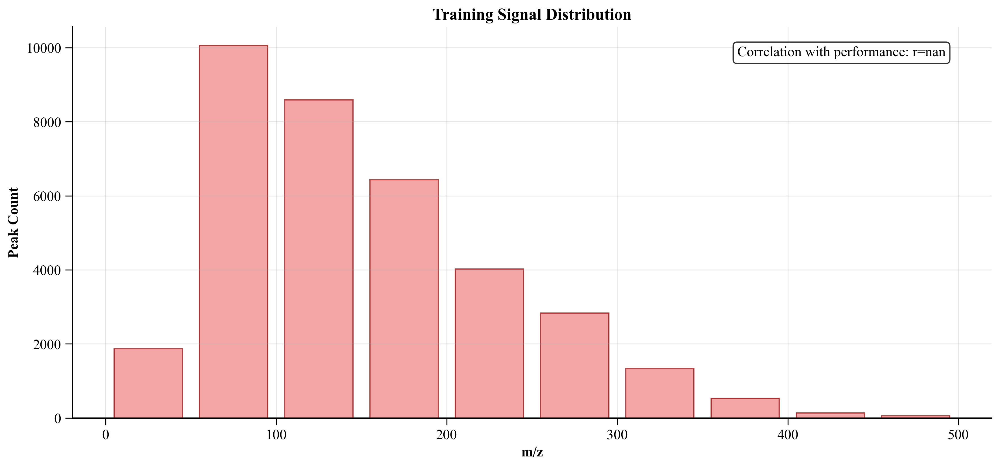

In [7]:
class MZRangeAnalyzer:
    """Analyze performance across m/z ranges and identify crossover points"""
    
    def __init__(self, config: Dict[str, Any]):
        self.config = config
        self.window_size = config['analysis']['mz_window']
    
    def calculate_range_performance(self, y_true: np.ndarray, y_pred: np.ndarray,
                                  metric: str = 'cosine_similarity') -> Dict[str, Any]:
        """Calculate performance metrics for each m/z range"""
        n_bins = y_true.shape[1]
        
        # Calculate performance for sliding windows
        ranges = []
        performances = []
        peak_counts = []
        
        for start in range(0, n_bins, self.window_size):
            end = min(start + self.window_size, n_bins)
            
            # Extract range data
            y_true_range = y_true[:, start:end]
            y_pred_range = y_pred[:, start:end]
            
            # Skip if no signal in this range
            if np.sum(y_true_range) == 0:
                continue
            
            # Calculate metrics
            if metric == 'cosine_similarity':
                similarities = []
                for i in range(len(y_true)):
                    if np.sum(y_true_range[i]) > 0 or np.sum(y_pred_range[i]) > 0:
                        cos_sim = 1 - cosine(y_true_range[i], y_pred_range[i])
                        similarities.append(cos_sim)
                    else:
                        similarities.append(1.0)  # Perfect if both empty
                performance = np.mean(similarities)
            elif metric == 'rmse':
                performance = np.sqrt(mean_squared_error(y_true_range.flatten(), 
                                                       y_pred_range.flatten()))
            else:
                raise ValueError(f"Unknown metric: {metric}")
            
            # Count peaks in this range
            peak_count = np.sum(y_true_range > 0.01)
            
            ranges.append((start, end))
            performances.append(performance)
            peak_counts.append(peak_count)
        
        return {
            'ranges': ranges,
            'performances': np.array(performances),
            'peak_counts': np.array(peak_counts),
            'metric': metric
        }
    
    def find_crossover_points(self, performance_dict: Dict[str, Dict]) -> List[Dict]:
        """Find crossover points where model rankings change"""
        model_names = list(performance_dict.keys())
        if len(model_names) < 2:
            return []
        
        crossovers = []
        
        # Get common ranges
        ranges = performance_dict[model_names[0]]['ranges']
        mz_centers = [(r[0] + r[1]) / 2 for r in ranges]
        
        # Compare each pair of models
        for i in range(len(model_names)):
            for j in range(i + 1, len(model_names)):
                perf1 = performance_dict[model_names[i]]['performances']
                perf2 = performance_dict[model_names[j]]['performances']
                
                # Find crossover points
                diff = perf1 - perf2
                
                # Smooth the difference for robust crossover detection
                if len(diff) > 5:
                    # Use spline for smoothing
                    spline = UnivariateSpline(mz_centers, diff, 
                                            s=len(diff)*0.01, k=3)
                    smooth_diff = spline(mz_centers)
                else:
                    smooth_diff = diff
                
                # Find zero crossings
                sign_changes = np.where(np.diff(np.sign(smooth_diff)))[0]
                
                for idx in sign_changes:
                    if idx < len(mz_centers) - 1:
                        # Interpolate exact crossover point
                        mz1, mz2 = mz_centers[idx], mz_centers[idx + 1]
                        d1, d2 = smooth_diff[idx], smooth_diff[idx + 1]
                        
                        # Linear interpolation
                        crossover_mz = mz1 - d1 * (mz2 - mz1) / (d2 - d1)
                        
                        crossovers.append({
                            'model1': model_names[i],
                            'model2': model_names[j],
                            'crossover_mz': crossover_mz,
                            'performance_before': perf1[idx] if d1 > 0 else perf2[idx],
                            'performance_after': perf2[idx + 1] if d2 < 0 else perf1[idx + 1]
                        })
        
        return crossovers
    
    def plot_mz_range_analysis(self, performance_dict: Dict[str, Dict],
                              crossovers: List[Dict]) -> None:
        """Create comprehensive m/z range analysis plot"""
        
        # Get data from first model for x-axis and peak counts
        first_model = list(performance_dict.keys())[0]
        ranges = performance_dict[first_model]['ranges']
        mz_centers = [(r[0] + r[1]) / 2 for r in ranges]
        peak_counts = performance_dict[first_model]['peak_counts']
        
        # Plot 1: Performance by m/z range
        plt.figure(figsize=(14, 8))
        for model_name, data in performance_dict.items():
            color = MODEL_COLORS.get(model_name, '#95a5a6')
            plt.plot(mz_centers, data['performances'], 'o-', 
                    color=color, linewidth=2, markersize=6,
                    label=model_name, alpha=0.8)
        
        # Mark crossover points
        for crossover in crossovers:
            plt.axvline(x=crossover['crossover_mz'], color='orange', 
                       linestyle='--', alpha=0.6, linewidth=2)
            # Use abbreviated model names for space
            model1_short = crossover['model1'].split()[0][:3]
            model2_short = crossover['model2'].split()[0][:3]
            plt.text(crossover['crossover_mz'], plt.gca().get_ylim()[1] * 0.95,
                    f"{model1_short} ↔ {model2_short}",
                    rotation=90, va='top', ha='right', fontsize=9,
                    bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.5))
        
        plt.ylabel('Cosine Similarity', fontsize=12, fontweight='bold')
        plt.title('Model Performance by m/z Range', fontsize=14, fontweight='bold')
        plt.xlabel('m/z', fontsize=12, fontweight='bold')
        plt.legend(loc='best')
        plt.grid(True, alpha=0.3)
        plt.ylim(0, 1.0)
        
        save_path = os.path.join(self.config['paths']['figures_dir'], 
                                'mz_range_performance.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()
        
        # Plot 2: Training signal distribution
        plt.figure(figsize=(14, 6))
        bars = plt.bar(mz_centers, peak_counts, width=self.window_size * 0.8,
                      color='lightcoral', alpha=0.7, edgecolor='darkred')
        plt.ylabel('Peak Count', fontsize=12, fontweight='bold')
        plt.xlabel('m/z', fontsize=12, fontweight='bold')
        plt.title('Training Signal Distribution', fontsize=14, fontweight='bold')
        plt.grid(True, alpha=0.3)
        
        # Add correlation annotation
        # Calculate correlation between peak count and average performance
        avg_performance = np.mean([data['performances'] for data in performance_dict.values()], axis=0)
        corr = np.corrcoef(peak_counts, avg_performance)[0, 1]
        plt.text(0.95, 0.95, f'Correlation with performance: r={corr:.3f}',
                transform=plt.gca().transAxes, ha='right', va='top',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        save_path = os.path.join(self.config['paths']['figures_dir'], 
                                'training_signal_distribution.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()

# Perform m/z range analysis
print("\nAnalyzing performance by m/z range...")
mz_analyzer = MZRangeAnalyzer(DIAG_CONFIG)
range_performance = {}

# Calculate performance for each model
for model_name in diagnostic_data['predictions'].keys():
    print(f"  Calculating for {model_name}...")
    range_performance[model_name] = mz_analyzer.calculate_range_performance(
        diagnostic_data['y_test'],
        diagnostic_data['predictions'][model_name]
    )

# Find crossover points
crossovers = mz_analyzer.find_crossover_points(range_performance)
print(f"\nFound {len(crossovers)} crossover points:")
for crossover in crossovers:
    print(f"  {crossover['model1']} ↔ {crossover['model2']} at m/z {crossover['crossover_mz']:.1f}")

# Create visualization
mz_analyzer.plot_mz_range_analysis(range_performance, crossovers)

## 8. Model Performance Comparison

Statistical comparison of all 8 models with confidence intervals and significance testing.

Creating performance comparison visualizations for all 8 models...


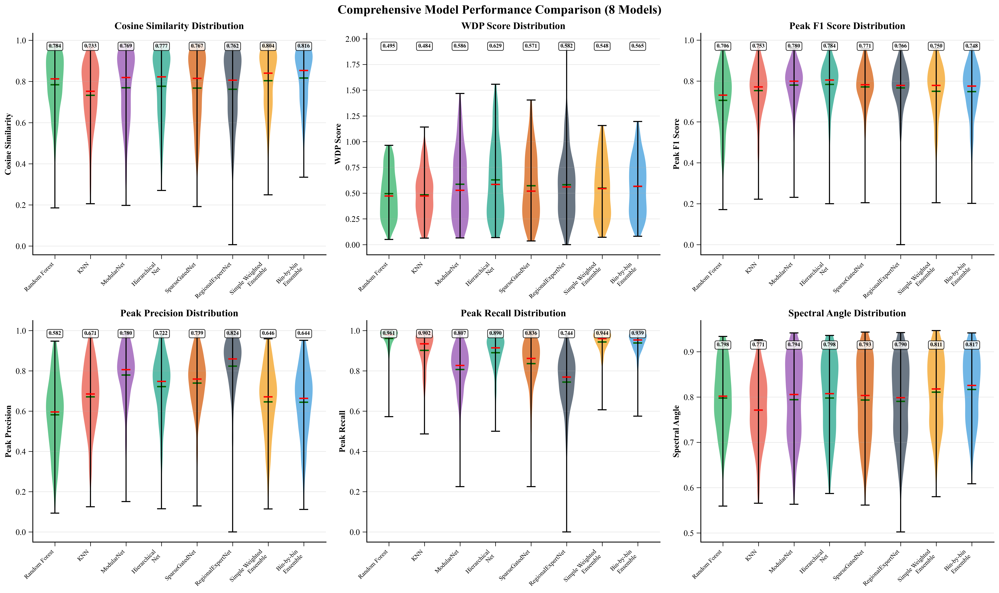


Model Performance Ranking (All 8 Models):
                       Model Cosine Similarity Median Cosine        WDP Score          Peak F1 Spectral Angle 5th Percentile 95th Percentile
1        Bin-by-bin Ensemble   0.8164 ± 0.1357        0.8535  0.5646 ± 0.2654  0.7477 ± 0.1333         0.8167         0.5633          0.9681
2   Simple Weighted Ensemble   0.8037 ± 0.1455        0.8403  0.5482 ± 0.2721  0.7501 ± 0.1345         0.8107         0.5445          0.9724
3              Random Forest   0.7837 ± 0.1397        0.8125  0.4948 ± 0.2316  0.7057 ± 0.1481         0.7976         0.5391          0.9631
4  HierarchicalPredictionNet   0.7770 ± 0.1660        0.8225  0.6288 ± 0.3682  0.7837 ± 0.1120         0.7976         0.4595          0.9654
5                 ModularNet   0.7691 ± 0.1710        0.8191  0.5861 ± 0.3333  0.7798 ± 0.1059         0.7939         0.4497          0.9643
6             SparseGatedNet   0.7674 ± 0.1734        0.8148  0.5714 ± 0.3247  0.7707 ± 0.1088         0.7933  

In [8]:
def plot_model_performance_comparison(similarity_results: Dict[str, Dict]) -> None:
    """Create comprehensive model performance comparison plots for all 8 models."""
    
    # Create comprehensive comparison figure
    fig, axes = plt.subplots(2, 3, figsize=(20, 12))
    fig.suptitle('Comprehensive Model Performance Comparison (8 Models)', fontsize=18, fontweight='bold')
    
    metrics = [
        ('cosine_similarities', 'Cosine Similarity', (0, 0)),
        ('wdp_scores', 'WDP Score', (0, 1)),
        ('peak_f1', 'Peak F1 Score', (0, 2)),
        ('peak_precision', 'Peak Precision', (1, 0)),
        ('peak_recall', 'Peak Recall', (1, 1)),
        ('spectral_angles', 'Spectral Angle', (1, 2))
    ]
    
    model_names = list(similarity_results.keys())
    
    for metric_key, metric_name, (row, col) in metrics:
        ax = axes[row, col]
        
        # Collect data for this metric
        data_for_plot = []
        labels = []
        colors = []
        
        for model_name in model_names:
            metric_data = similarity_results[model_name][metric_key]
            data_for_plot.append(metric_data)
            # Shorten labels for display
            if 'Ensemble' in model_name:
                labels.append(model_name.replace(' Ensemble', '\nEnsemble'))
            elif 'PredictionNet' in model_name:
                labels.append(model_name.replace('PredictionNet', '\nNet'))
            else:
                labels.append(model_name.replace('_', '\n'))
            colors.append(MODEL_COLORS.get(model_name, '#95a5a6'))
        
        # Create violin plot with box plot overlay
        parts = ax.violinplot(data_for_plot, positions=range(len(model_names)), 
                             showmeans=True, showmedians=True)
        
        # Color the violin plots
        for i, (pc, color) in enumerate(zip(parts['bodies'], colors)):
            pc.set_facecolor(color)
            pc.set_alpha(0.7)
        
        # Customize violin plot colors
        parts['cmeans'].set_color('darkgreen')
        parts['cmeans'].set_linewidth(2)
        parts['cmedians'].set_color('red')
        parts['cmedians'].set_linewidth(2)
        parts['cbars'].set_color('black')
        parts['cmaxes'].set_color('black')
        parts['cmins'].set_color('black')
        
        ax.set_xticks(range(len(model_names)))
        ax.set_xticklabels(labels, rotation=45, ha='right', fontsize=9)
        ax.set_ylabel(metric_name, fontweight='bold')
        ax.set_title(f'{metric_name} Distribution', fontweight='bold')
        ax.grid(True, alpha=0.3, axis='y')
        
        # Add mean values as text
        for i, model_name in enumerate(model_names):
            mean_val = np.mean(similarity_results[model_name][metric_key])
            ax.text(i, ax.get_ylim()[1] * 0.95, f'{mean_val:.3f}', 
                   ha='center', va='top', fontweight='bold', fontsize=8,
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    plt.tight_layout()
    save_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 'model_performance_comparison_8models.png')
    plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()

def create_performance_ranking_table(similarity_results: Dict[str, Dict]) -> pd.DataFrame:
    """Create comprehensive performance ranking table for all 8 models."""
    
    ranking_data = []
    
    for model_name, results in similarity_results.items():
        summary = results['summary']
        ranking_data.append({
            'Model': model_name,
            'Cosine Similarity': f"{summary['mean_cosine']:.4f} ± {summary['std_cosine']:.4f}",
            'Median Cosine': f"{summary['median_cosine']:.4f}",
            'WDP Score': f"{summary['mean_wdp']:.4f} ± {summary['std_wdp']:.4f}",
            'Peak F1': f"{summary['mean_peak_f1']:.4f} ± {summary['std_peak_f1']:.4f}",
            'Spectral Angle': f"{summary['mean_spectral_angle']:.4f}",
            '5th Percentile': f"{summary['percentile_5']:.4f}",
            '95th Percentile': f"{summary['percentile_95']:.4f}",
            'Cosine_Raw': summary['mean_cosine'],
            'WDP_Raw': summary['mean_wdp'],
            'F1_Raw': summary['mean_peak_f1']
        })
    
    df = pd.DataFrame(ranking_data)
    
    # Sort by cosine similarity (primary metric)
    df = df.sort_values('Cosine_Raw', ascending=False)
    df = df.drop(['Cosine_Raw', 'WDP_Raw', 'F1_Raw'], axis=1)
    df.reset_index(drop=True, inplace=True)
    df.index += 1  # Start ranking from 1
    
    return df

# Create performance comparison plots
print("Creating performance comparison visualizations for all 8 models...")
plot_model_performance_comparison(similarity_results)

# Create performance ranking table
ranking_table = create_performance_ranking_table(similarity_results)
print("\nModel Performance Ranking (All 8 Models):")
print("=" * 100)
print(ranking_table.to_string())

# Save ranking table to CSV
ranking_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 'model_performance_ranking.csv')
ranking_table.to_csv(ranking_path)
print(f"\nRanking table saved to: {ranking_path}")

# Find best performing model
best_model_name = max(similarity_results.keys(), 
                     key=lambda x: similarity_results[x]['summary']['mean_cosine'])
best_cosine = similarity_results[best_model_name]['summary']['mean_cosine']

print(f"\n{'='*60}")
print(f"Best performing model: {best_model_name}")
print(f"Best cosine similarity: {best_cosine:.6f}")
print(f"{'='*60}")

## 9. Ensemble Weight Analysis

Analyze the weight distribution in ensemble models to understand model complementarity.


Analyzing ensemble weights...

Bin-by-bin ensemble statistics:
  Number of bins: 500
  Number of models: 6
  Average weight entropy: 1.186
  Weight diversity: 66.2%


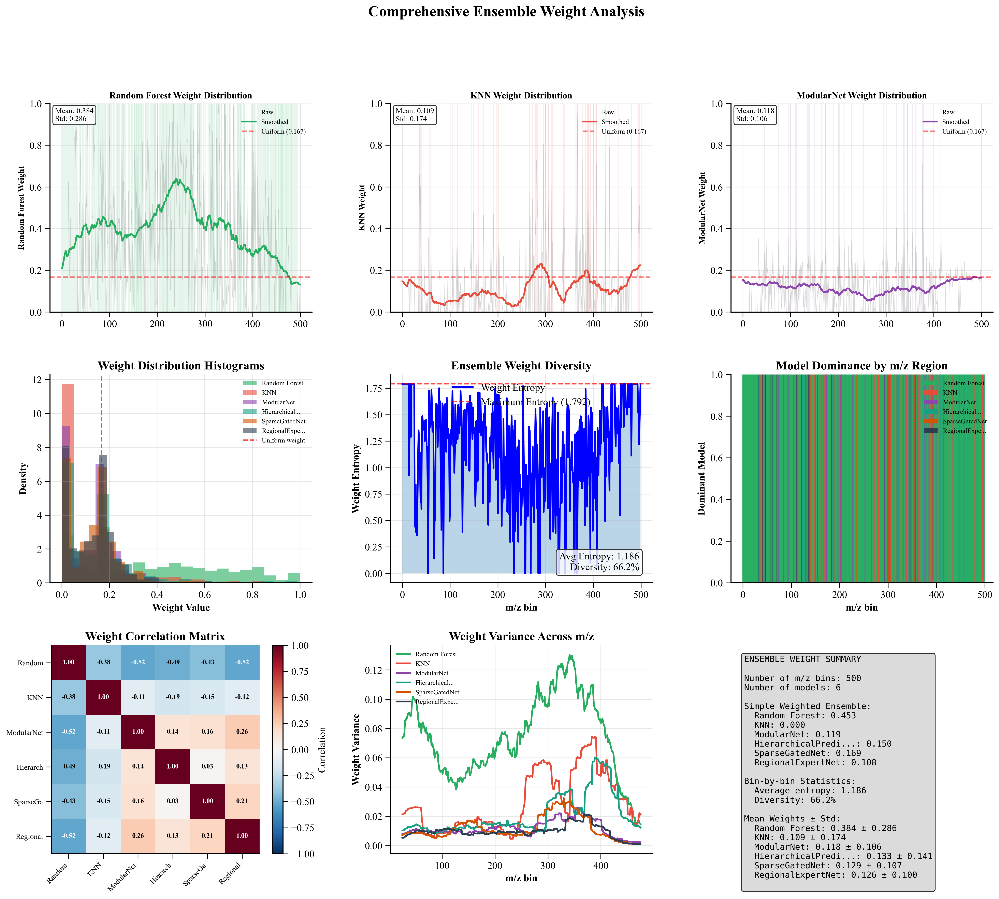

In [9]:
class EnsembleWeightAnalyzer:
    """Analyze ensemble weight distribution and model complementarity with multi-pane plots"""
    
    def __init__(self, config: Dict[str, Any]):
        self.config = config
        self.smoothing_window = config['analysis']['smoothing_window']
    
    def analyze_ensemble_weights(self, ensemble_data: Dict[str, Any]) -> Dict[str, Any]:
        """Analyze ensemble weight patterns from new ensemble format"""
        if ensemble_data is None:
            return None
        
        results = {}
        
        # Default model names for 6 models (based on typical ensemble)
        default_model_names = [
            'Random Forest', 'KNN', 'ModularNet',
            'HierarchicalPredictionNet', 'SparseGatedNet', 'RegionalExpertNet'
        ]
        
        # Analyze simple weighted ensemble
        if 'simple_weighted' in ensemble_data:
            simple_weights_data = ensemble_data['simple_weighted']['weights']
            
            # Handle both dictionary and array formats
            if isinstance(simple_weights_data, dict):
                # Weights are stored as a dictionary
                model_names_simple = list(simple_weights_data.keys())
                simple_weights = np.array(list(simple_weights_data.values()), dtype=float)
            else:
                # Weights are stored as an array
                simple_weights = np.array(simple_weights_data, dtype=float)
                model_names_simple = ensemble_data['simple_weighted'].get('model_names', 
                    default_model_names[:len(simple_weights)])
            
            results['simple_weighted'] = {
                'weights': simple_weights,
                'type': 'uniform',
                'model_names': model_names_simple
            }
        
        # Analyze bin-by-bin ensemble
        if 'bin_by_bin' in ensemble_data:
            bin_weights = ensemble_data['bin_by_bin']['weights']
            # Ensure weights are numpy array of floats
            if not isinstance(bin_weights, np.ndarray):
                bin_weights = np.array(bin_weights, dtype=float)
            else:
                bin_weights = bin_weights.astype(float)
            
            n_models_bin = bin_weights.shape[1]
            
            # Get model names
            if 'model_names' in ensemble_data['bin_by_bin']:
                model_names_bin = ensemble_data['bin_by_bin']['model_names']
            elif 'simple_weighted' in results:
                # Use model names from simple weighted if available
                model_names_bin = results['simple_weighted']['model_names']
                if len(model_names_bin) < n_models_bin:
                    model_names_bin = model_names_bin + default_model_names[len(model_names_bin):n_models_bin]
            else:
                model_names_bin = default_model_names[:n_models_bin]
            
            # Calculate statistics
            weight_stats = {
                'mean_weights': np.mean(bin_weights, axis=0),
                'std_weights': np.std(bin_weights, axis=0),
                'min_weights': np.min(bin_weights, axis=0),
                'max_weights': np.max(bin_weights, axis=0)
            }
            
            # Find dominant model for each bin
            dominant_model = np.argmax(bin_weights, axis=1)
            
            # Calculate weight entropy (diversity)
            weight_entropy = []
            for weights in bin_weights:
                # Add small epsilon to avoid log(0)
                weights_norm = weights + 1e-10
                weights_norm = weights_norm / np.sum(weights_norm)
                entropy = -np.sum(weights_norm * np.log(weights_norm))
                weight_entropy.append(entropy)
            
            results['bin_by_bin'] = {
                'weights': bin_weights,
                'type': 'adaptive',
                'stats': weight_stats,
                'dominant_model': dominant_model,
                'weight_entropy': np.array(weight_entropy),
                'max_entropy': np.log(bin_weights.shape[1]),  # Maximum possible entropy
                'model_names': model_names_bin
            }
        
        return results
    
    def plot_ensemble_weights_multipane(self, weight_analysis: Dict[str, Any]) -> None:
        """Create comprehensive multi-pane ensemble weight visualization"""
        if weight_analysis is None or 'bin_by_bin' not in weight_analysis:
            print("No ensemble weight data available for visualization.")
            return
        
        bin_data = weight_analysis['bin_by_bin']
        bin_weights = bin_data['weights']
        n_bins, n_models = bin_weights.shape
        
        # Get model names from ensemble data
        model_names = bin_data.get('model_names', [f'Model {i+1}' for i in range(n_models)])
        if len(model_names) < n_models:
            # Extend with generic names if needed
            model_names = list(model_names) + [f'Model {i+1}' for i in range(len(model_names), n_models)]
        
        # Get colors for each model
        model_colors = []
        default_colors = ['#e74c3c', '#27ae60', '#8e44ad', '#16a085', '#d35400', '#2c3e50']
        for i, name in enumerate(model_names[:n_models]):
            if name in MODEL_COLORS:
                model_colors.append(MODEL_COLORS[name])
            else:
                # Use default color scheme
                model_colors.append(default_colors[i % len(default_colors)])
        
        # Create comprehensive multi-pane figure
        fig = plt.figure(figsize=(20, 16))
        gs = fig.add_gridspec(3, 3, hspace=0.3, wspace=0.3)
        
        # Plot 1-3: Individual model weight distributions (top row)
        mz_bins = np.arange(n_bins)
        
        # Only plot first 3 models in top row (or fewer if less than 3)
        for idx in range(min(3, n_models)):
            model_name = model_names[idx]
            color = model_colors[idx]
            
            ax = fig.add_subplot(gs[0, idx])
            
            weights = bin_weights[:, idx]
            
            # Plot raw weights
            ax.plot(mz_bins, weights, alpha=0.3, color='gray', linewidth=0.5, label='Raw')
            
            # Plot smoothed weights
            if len(weights) > self.smoothing_window:
                weights_smooth = uniform_filter1d(weights, size=self.smoothing_window)
            else:
                weights_smooth = weights
            
            ax.plot(mz_bins, weights_smooth, color=color, linewidth=2, label='Smoothed')
            
            # Add reference line for uniform weight
            ax.axhline(y=1/n_models, color='red', linestyle='--', alpha=0.5,
                       label=f'Uniform ({1/n_models:.3f})')
            
            # Highlight regions where this model dominates
            dominant_mask = bin_data['dominant_model'] == idx
            ax.fill_between(mz_bins, 0, 1, where=dominant_mask,
                           alpha=0.1, color=color)
            
            # Shorten long model names for display
            display_name = model_name if len(model_name) <= 20 else model_name[:17] + '...'
            ax.set_ylabel(f'{display_name} Weight', fontweight='bold', fontsize=10)
            ax.set_title(f'{display_name} Weight Distribution', fontweight='bold', fontsize=11)
            ax.set_ylim(0, 1)
            ax.grid(True, alpha=0.3)
            ax.legend(loc='upper right', fontsize=8)
            
            # Add statistics
            stats_text = (f"Mean: {bin_data['stats']['mean_weights'][idx]:.3f}\n"
                         f"Std: {bin_data['stats']['std_weights'][idx]:.3f}")
            ax.text(0.02, 0.98, stats_text, transform=ax.transAxes,
                    verticalalignment='top', fontsize=9,
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # Plot 4: Weight histograms (middle left)
        ax4 = fig.add_subplot(gs[1, 0])
        for idx in range(n_models):
            model_name = model_names[idx]
            color = model_colors[idx]
            weights = bin_weights[:, idx]
            # Shorten name for legend
            display_name = model_name if len(model_name) <= 15 else model_name[:12] + '...'
            ax4.hist(weights, bins=20, alpha=0.6, color=color, label=display_name, density=True)
        
        ax4.axvline(x=1/n_models, color='red', linestyle='--', alpha=0.7,
                   label='Uniform weight')
        ax4.set_xlabel('Weight Value', fontweight='bold')
        ax4.set_ylabel('Density', fontweight='bold')
        ax4.set_title('Weight Distribution Histograms', fontweight='bold')
        ax4.grid(True, alpha=0.3)
        ax4.legend(fontsize=8, loc='best')
        
        # Plot 5: Weight entropy (middle center)
        ax5 = fig.add_subplot(gs[1, 1])
        weight_entropy = bin_data['weight_entropy']
        max_entropy = bin_data['max_entropy']
        
        ax5.plot(mz_bins, weight_entropy, 'b-', linewidth=2, label='Weight Entropy')
        ax5.axhline(y=max_entropy, color='red', linestyle='--', alpha=0.7,
                  label=f'Maximum Entropy ({max_entropy:.3f})')
        ax5.fill_between(mz_bins, 0, weight_entropy, alpha=0.3)
        
        ax5.set_xlabel('m/z bin', fontweight='bold')
        ax5.set_ylabel('Weight Entropy', fontweight='bold')
        ax5.set_title('Ensemble Weight Diversity', fontweight='bold')
        ax5.grid(True, alpha=0.3)
        ax5.legend()
        
        # Add interpretation
        avg_entropy = np.mean(weight_entropy)
        ax5.text(0.95, 0.05, f'Avg Entropy: {avg_entropy:.3f}\n'
                           f'Diversity: {avg_entropy/max_entropy*100:.1f}%',
               transform=ax5.transAxes, ha='right', va='bottom',
               bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # Plot 6: Model dominance map (middle right)
        ax6 = fig.add_subplot(gs[1, 2])
        dominance_colors = [model_colors[min(i, len(model_colors)-1)] for i in bin_data['dominant_model']]
        
        # Create dominance visualization
        for idx, color in enumerate(dominance_colors):
            ax6.axvline(x=idx, color=color, alpha=0.7, linewidth=2)
        
        ax6.set_xlabel('m/z bin', fontweight='bold')
        ax6.set_ylabel('Dominant Model', fontweight='bold')
        ax6.set_title('Model Dominance by m/z Region', fontweight='bold')
        
        # Add legend for dominance
        from matplotlib.patches import Patch
        legend_elements = []
        for i in range(n_models):
            display_name = model_names[i] if len(model_names[i]) <= 15 else model_names[i][:12] + '...'
            legend_elements.append(Patch(facecolor=model_colors[i], label=display_name))
        ax6.legend(handles=legend_elements, loc='upper right', fontsize=8)
        
        # Plot 7: Weight correlation matrix (bottom left)
        ax7 = fig.add_subplot(gs[2, 0])
        corr_matrix = np.corrcoef(bin_weights.T)
        
        im = ax7.imshow(corr_matrix, cmap='RdBu_r', vmin=-1, vmax=1)
        ax7.set_xticks(range(n_models))
        ax7.set_yticks(range(n_models))
        
        # Use abbreviated names for tick labels
        abbreviated_names = []
        for name in model_names[:n_models]:
            if len(name) <= 10:
                abbreviated_names.append(name)
            else:
                # Create abbreviation (first word or first 8 chars)
                words = name.split()
                if len(words) > 1:
                    abbreviated_names.append(words[0][:8])
                else:
                    abbreviated_names.append(name[:8])
        
        ax7.set_xticklabels(abbreviated_names, rotation=45, ha='right', fontsize=9)
        ax7.set_yticklabels(abbreviated_names, fontsize=9)
        ax7.set_title('Weight Correlation Matrix', fontweight='bold')
        
        # Add correlation values (only if matrix is not too large)
        if n_models <= 6:
            for i in range(n_models):
                for j in range(n_models):
                    text = ax7.text(j, i, f'{corr_matrix[i, j]:.2f}',
                                   ha="center", va="center", 
                                   color="white" if abs(corr_matrix[i, j]) > 0.5 else "black",
                                   fontweight='bold', fontsize=8)
        
        plt.colorbar(im, ax=ax7, label='Correlation')
        
        # Plot 8: Weight variance across m/z (bottom center)
        ax8 = fig.add_subplot(gs[2, 1])
        
        for idx in range(n_models):
            model_name = model_names[idx]
            color = model_colors[idx]
            weights = bin_weights[:, idx]
            # Calculate rolling variance
            window = min(50, len(weights)//4)
            rolling_var = pd.Series(weights).rolling(window=window, center=True).var()
            display_name = model_name if len(model_name) <= 15 else model_name[:12] + '...'
            ax8.plot(mz_bins, rolling_var, color=color, linewidth=2, label=display_name)
        
        ax8.set_xlabel('m/z bin', fontweight='bold')
        ax8.set_ylabel('Weight Variance', fontweight='bold')
        ax8.set_title('Weight Variance Across m/z', fontweight='bold')
        ax8.grid(True, alpha=0.3)
        ax8.legend(fontsize=8, loc='best')
        
        # Plot 9: Summary statistics (bottom right)
        ax9 = fig.add_subplot(gs[2, 2])
        ax9.axis('off')
        
        # Create summary table
        summary_text = "ENSEMBLE WEIGHT SUMMARY\n\n"
        summary_text += f"Number of m/z bins: {n_bins}\n"
        summary_text += f"Number of models: {n_models}\n\n"
        
        # Simple weighted ensemble info
        if 'simple_weighted' in weight_analysis:
            simple_data = weight_analysis['simple_weighted']
            simple_weights = simple_data['weights']
            simple_model_names = simple_data['model_names']
            
            summary_text += "Simple Weighted Ensemble:\n"
            for i, name in enumerate(simple_model_names):
                if i < len(simple_weights):
                    weight_val = float(simple_weights[i])
                    display_name = name if len(name) <= 20 else name[:17] + '...'
                    summary_text += f"  {display_name}: {weight_val:.3f}\n"
            summary_text += "\n"
        
        # Bin-by-bin stats
        summary_text += "Bin-by-bin Statistics:\n"
        summary_text += f"  Average entropy: {avg_entropy:.3f}\n"
        summary_text += f"  Diversity: {avg_entropy/max_entropy*100:.1f}%\n\n"
        
        summary_text += "Mean Weights ± Std:\n"
        for i in range(n_models):
            name = model_names[i]
            display_name = name if len(name) <= 20 else name[:17] + '...'
            mean_w = float(bin_data['stats']['mean_weights'][i])
            std_w = float(bin_data['stats']['std_weights'][i])
            summary_text += f"  {display_name}: {mean_w:.3f} ± {std_w:.3f}\n"
        
        ax9.text(0.05, 0.95, summary_text, transform=ax9.transAxes,
                fontsize=10, verticalalignment='top',
                bbox=dict(boxstyle='round', facecolor='lightgray', alpha=0.8),
                family='monospace')
        
        plt.suptitle('Comprehensive Ensemble Weight Analysis', fontsize=18, fontweight='bold')
        
        save_path = os.path.join(self.config['paths']['figures_dir'],
                                'ensemble_weight_analysis_multipane.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()

# Analyze ensemble weights
if diagnostic_data['ensemble_data'] is not None:
    print("\nAnalyzing ensemble weights...")
    ensemble_analyzer = EnsembleWeightAnalyzer(DIAG_CONFIG)
    weight_analysis = ensemble_analyzer.analyze_ensemble_weights(diagnostic_data['ensemble_data'])
    
    if weight_analysis and 'bin_by_bin' in weight_analysis:
        bin_data = weight_analysis['bin_by_bin']
        print(f"\nBin-by-bin ensemble statistics:")
        print(f"  Number of bins: {bin_data['weights'].shape[0]}")
        print(f"  Number of models: {bin_data['weights'].shape[1]}")
        print(f"  Average weight entropy: {np.mean(bin_data['weight_entropy']):.3f}")
        print(f"  Weight diversity: {np.mean(bin_data['weight_entropy'])/bin_data['max_entropy']*100:.1f}%")
        
        # Create multi-pane visualization
        ensemble_analyzer.plot_ensemble_weights_multipane(weight_analysis)
else:
    print("\nNo ensemble data available for weight analysis.")
    print("This is expected if ensemble_results.pkl was not found.")

## 10. Intensity-Dependent Error Analysis

Analyze how model performance varies with peak intensity levels.


Performing intensity-dependent error analysis...

Random Forest:
  Overall correlation: 0.6525
  0-10%: RMSE=0.0401, Bias=+0.0123, n=4,255
  10-25%: RMSE=0.0452, Bias=+0.0089, n=6,018
  25-50%: RMSE=0.0491, Bias=+0.0053, n=7,792
  50-75%: RMSE=0.0623, Bias=-0.0124, n=8,878
  75-100%: RMSE=0.2244, Bias=-0.1303, n=8,925


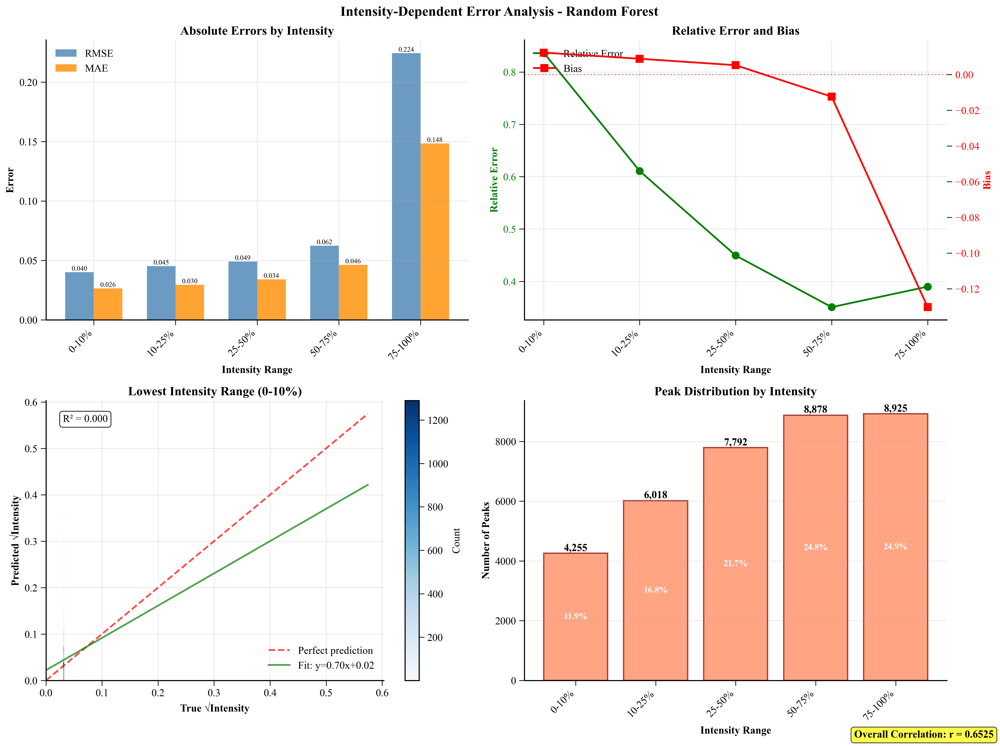


KNN:
  Overall correlation: 0.6030
  0-10%: RMSE=0.0499, Bias=+0.0065, n=4,255
  10-25%: RMSE=0.0580, Bias=+0.0045, n=6,018
  25-50%: RMSE=0.0658, Bias=+0.0033, n=7,792
  50-75%: RMSE=0.0803, Bias=-0.0110, n=8,878
  75-100%: RMSE=0.2310, Bias=-0.1243, n=8,925


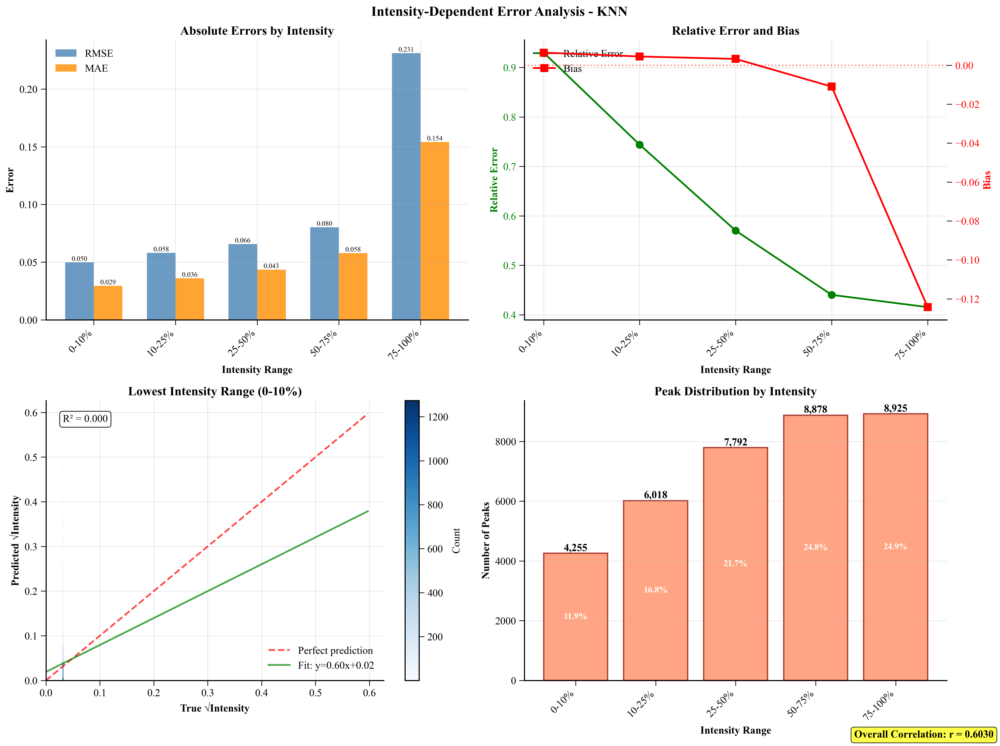


ModularNet:
  Overall correlation: 0.6307
  0-10%: RMSE=0.0512, Bias=-0.0042, n=4,255
  10-25%: RMSE=0.0561, Bias=-0.0058, n=6,018
  25-50%: RMSE=0.0653, Bias=-0.0055, n=7,792
  50-75%: RMSE=0.0820, Bias=-0.0185, n=8,878
  75-100%: RMSE=0.2302, Bias=-0.1229, n=8,925


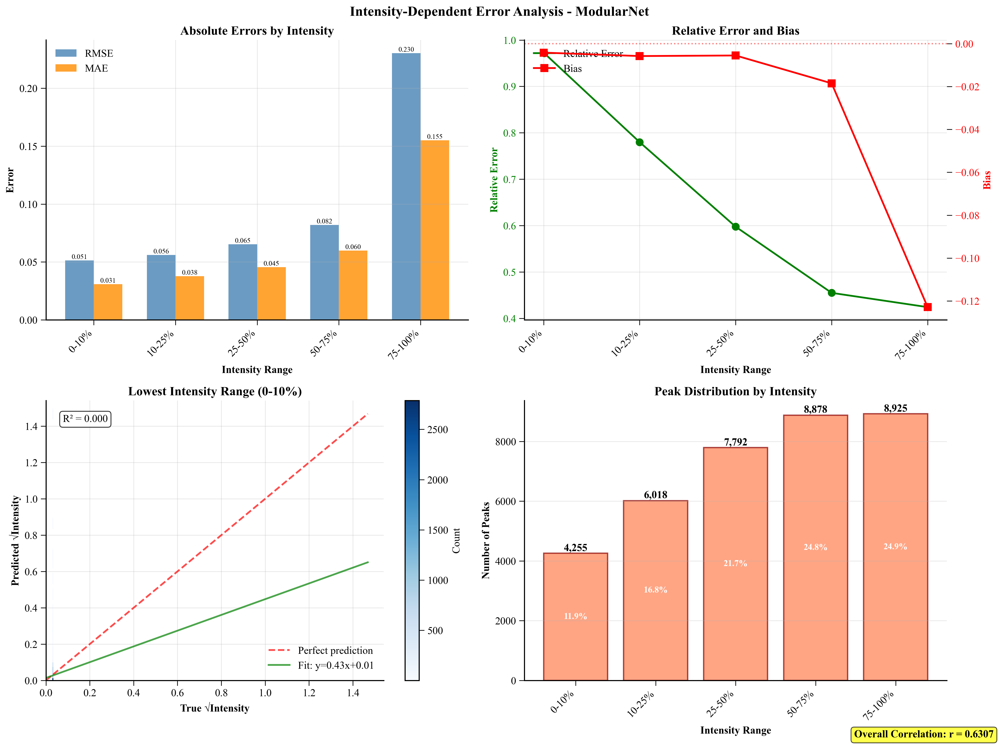


HierarchicalPredictionNet:
  Overall correlation: 0.6250
  0-10%: RMSE=0.0529, Bias=+0.0074, n=4,255
  10-25%: RMSE=0.0568, Bias=+0.0062, n=6,018
  25-50%: RMSE=0.0637, Bias=+0.0051, n=7,792
  50-75%: RMSE=0.0770, Bias=-0.0117, n=8,878
  75-100%: RMSE=0.2287, Bias=-0.1211, n=8,925


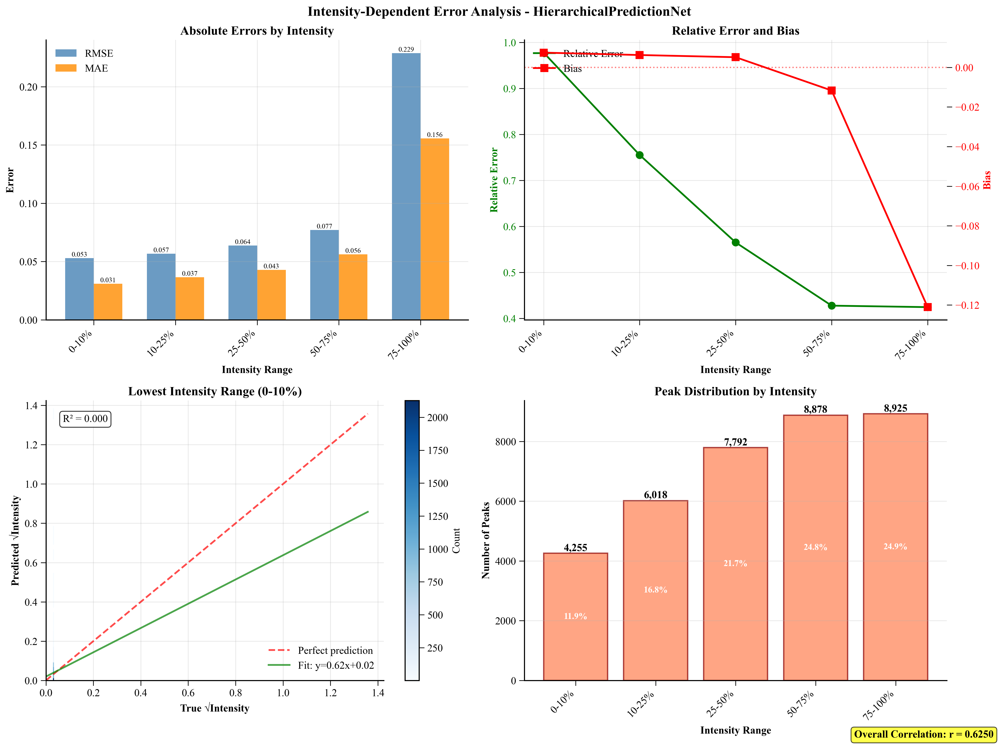


SparseGatedNet:
  Overall correlation: 0.6242
  0-10%: RMSE=0.0457, Bias=-0.0018, n=4,255
  10-25%: RMSE=0.0554, Bias=-0.0039, n=6,018
  25-50%: RMSE=0.0636, Bias=-0.0049, n=7,792
  50-75%: RMSE=0.0807, Bias=-0.0188, n=8,878
  75-100%: RMSE=0.2329, Bias=-0.1282, n=8,925


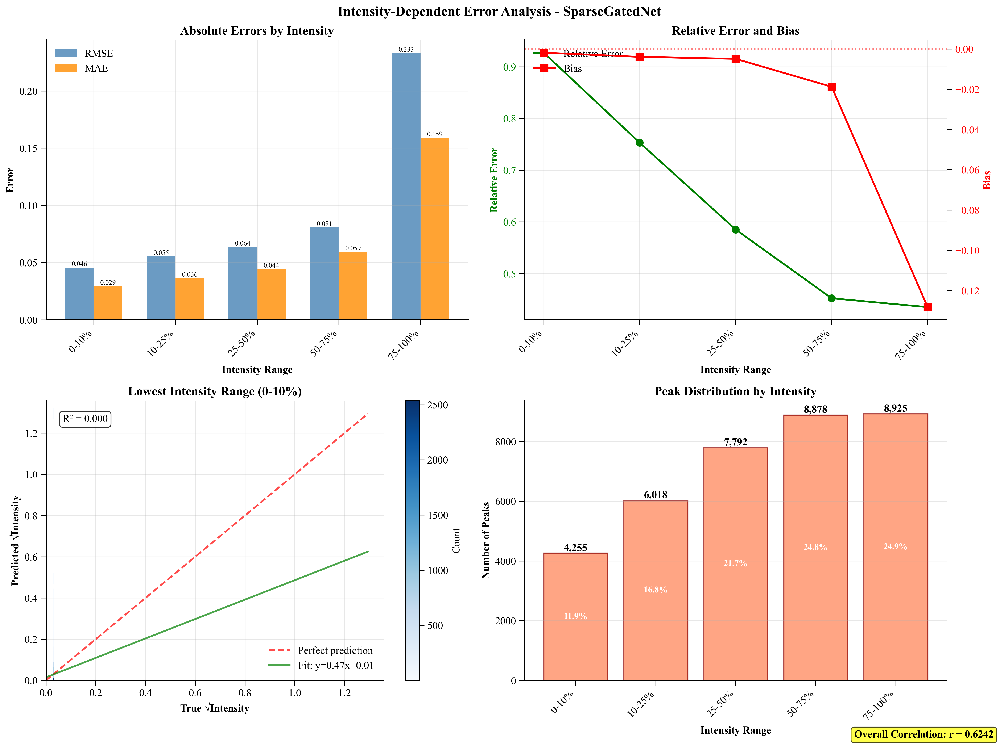


RegionalExpertNet:
  Overall correlation: 0.6107
  0-10%: RMSE=0.0564, Bias=-0.0066, n=4,255
  10-25%: RMSE=0.0642, Bias=-0.0067, n=6,018
  25-50%: RMSE=0.0748, Bias=-0.0042, n=7,792
  50-75%: RMSE=0.0863, Bias=-0.0143, n=8,878
  75-100%: RMSE=0.2331, Bias=-0.1180, n=8,925


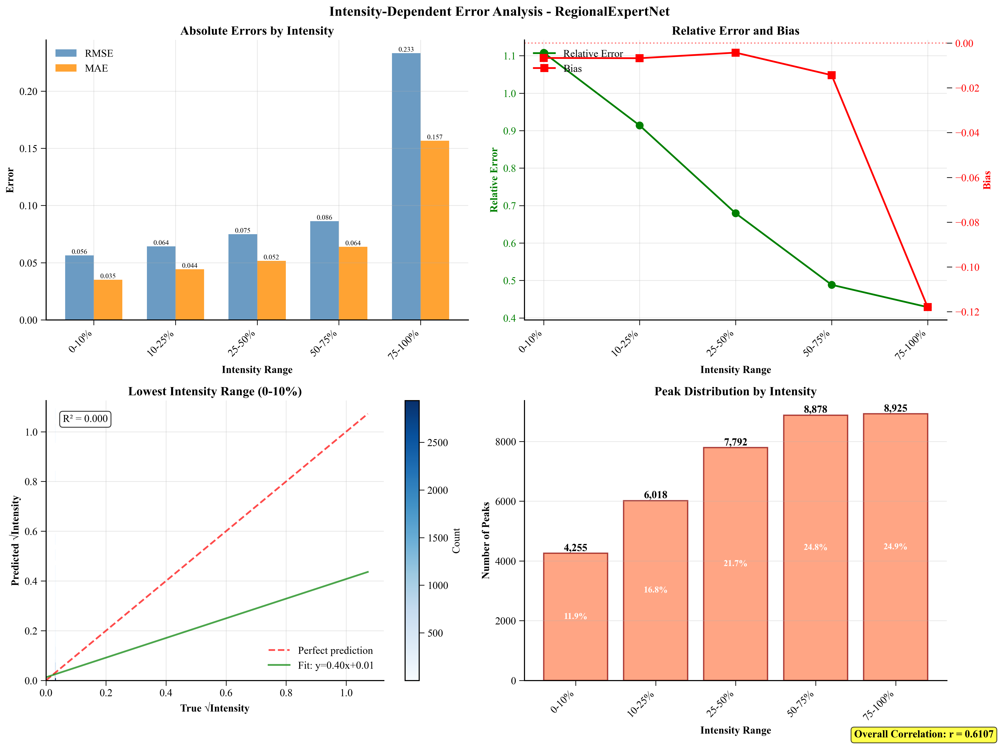


Simple Weighted Ensemble:
  Overall correlation: 0.6701
  0-10%: RMSE=0.0390, Bias=+0.0052, n=4,255
  10-25%: RMSE=0.0448, Bias=+0.0029, n=6,018
  25-50%: RMSE=0.0505, Bias=+0.0012, n=7,792
  50-75%: RMSE=0.0642, Bias=-0.0143, n=8,878
  75-100%: RMSE=0.2205, Bias=-0.1263, n=8,925


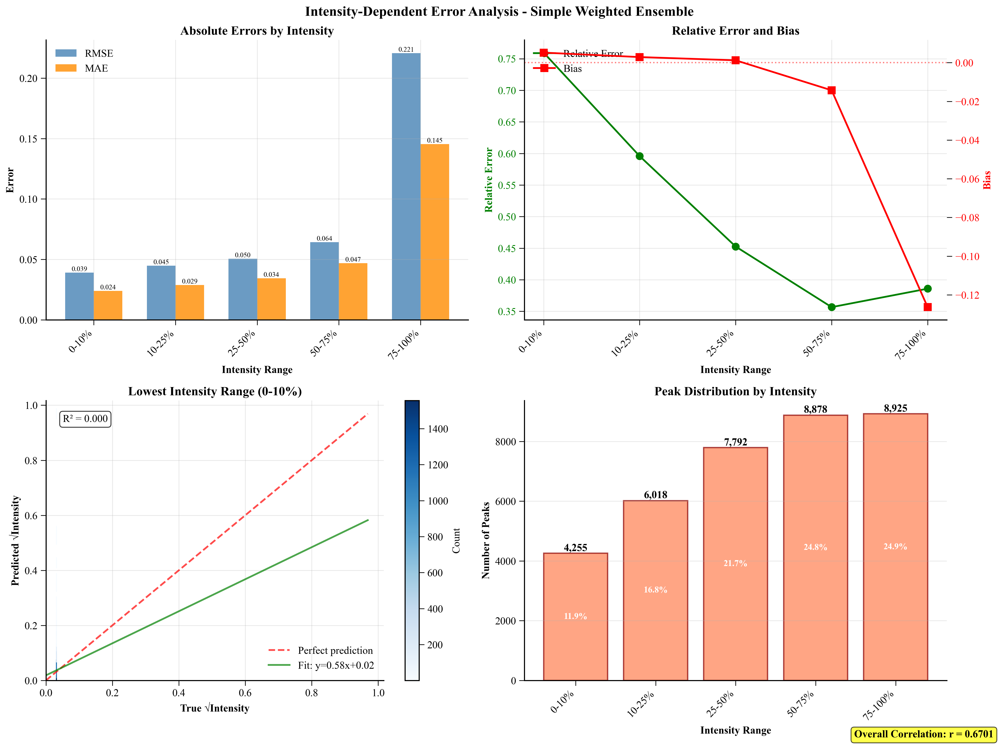


Bin-by-bin Ensemble:
  Overall correlation: 0.6899
  0-10%: RMSE=0.0367, Bias=+0.0048, n=4,255
  10-25%: RMSE=0.0429, Bias=+0.0024, n=6,018
  25-50%: RMSE=0.0495, Bias=+0.0007, n=7,792
  50-75%: RMSE=0.0633, Bias=-0.0146, n=8,878
  75-100%: RMSE=0.2149, Bias=-0.1226, n=8,925


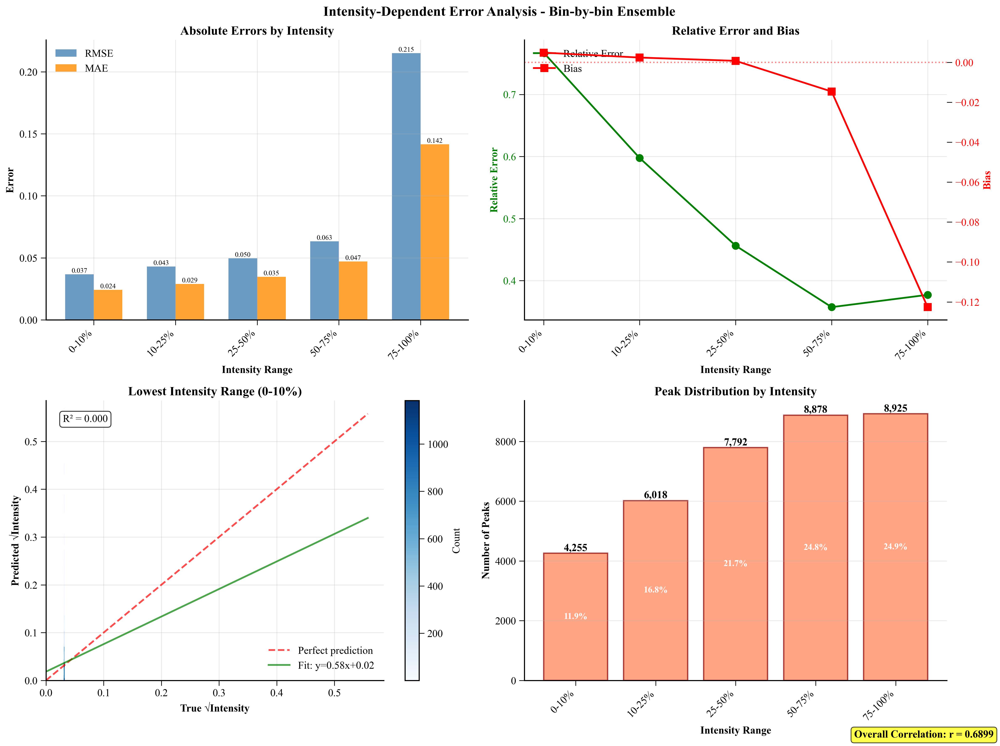

In [10]:
class IntensityErrorAnalyzer:
    """Analyze errors as a function of peak intensity"""
    
    def __init__(self, config: Dict[str, Any]):
        self.config = config
        self.percentiles = config['analysis']['intensity_percentiles']
    
    def analyze_intensity_errors(self, y_true: np.ndarray, y_pred: np.ndarray) -> Dict[str, Any]:
        """Analyze errors stratified by intensity levels"""
        # Flatten arrays
        y_true_flat = y_true.flatten()
        y_pred_flat = y_pred.flatten()
        
        # Remove zeros for percentile calculation
        nonzero_mask = y_true_flat > 0
        y_true_nonzero = y_true_flat[nonzero_mask]
        y_pred_nonzero = y_pred_flat[nonzero_mask]
        
        if len(y_true_nonzero) == 0:
            return None
        
        # Calculate percentile thresholds
        intensity_thresholds = np.percentile(y_true_nonzero, self.percentiles)
        
        # Analyze errors by intensity range
        intensity_ranges = []
        
        for i in range(len(intensity_thresholds)):
            if i == 0:
                mask = y_true_nonzero <= intensity_thresholds[i]
                range_name = f"0-{self.percentiles[i]}%"
            elif i == len(intensity_thresholds) - 1:
                mask = y_true_nonzero > intensity_thresholds[i-1]
                range_name = f"{self.percentiles[i-1]}-100%"
            else:
                mask = (y_true_nonzero > intensity_thresholds[i-1]) & \
                       (y_true_nonzero <= intensity_thresholds[i])
                range_name = f"{self.percentiles[i-1]}-{self.percentiles[i]}%"
            
            if np.sum(mask) > 0:
                true_range = y_true_nonzero[mask]
                pred_range = y_pred_nonzero[mask]
                
                # Calculate metrics
                rmse = np.sqrt(mean_squared_error(true_range, pred_range))
                mae = mean_absolute_error(true_range, pred_range)
                relative_error = np.mean(np.abs(pred_range - true_range) / (true_range + 1e-10))
                bias = np.mean(pred_range - true_range)
                
                intensity_ranges.append({
                    'range': range_name,
                    'threshold_low': intensity_thresholds[i-1] if i > 0 else 0,
                    'threshold_high': intensity_thresholds[i] if i < len(intensity_thresholds) else np.inf,
                    'n_peaks': np.sum(mask),
                    'rmse': rmse,
                    'mae': mae,
                    'relative_error': relative_error,
                    'bias': bias,
                    'true_values': true_range,
                    'pred_values': pred_range
                })
        
        return {
            'intensity_ranges': intensity_ranges,
            'thresholds': intensity_thresholds,
            'overall_correlation': np.corrcoef(y_true_nonzero, y_pred_nonzero)[0, 1]
        }
    
    def plot_intensity_error_analysis(self, error_analysis: Dict[str, Any], 
                                    model_name: str) -> None:
        """Create comprehensive intensity-dependent error visualization in 2x2 panel"""
        if error_analysis is None:
            return
        
        ranges_data = error_analysis['intensity_ranges']
        
        # Extract data for plotting
        range_names = [r['range'] for r in ranges_data]
        rmse_values = [r['rmse'] for r in ranges_data]
        mae_values = [r['mae'] for r in ranges_data]
        relative_errors = [r['relative_error'] for r in ranges_data]
        biases = [r['bias'] for r in ranges_data]
        n_peaks = [r['n_peaks'] for r in ranges_data]
        
        # Create 2x2 subplot figure
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle(f'Intensity-Dependent Error Analysis - {model_name}', 
                     fontsize=16, fontweight='bold')
        
        # Plot 1: RMSE and MAE by intensity range (top left)
        ax1 = axes[0, 0]
        x = np.arange(len(range_names))
        width = 0.35
        
        bars1 = ax1.bar(x - width/2, rmse_values, width, label='RMSE', alpha=0.8, color='steelblue')
        bars2 = ax1.bar(x + width/2, mae_values, width, label='MAE', alpha=0.8, color='darkorange')
        
        ax1.set_xlabel('Intensity Range', fontweight='bold')
        ax1.set_ylabel('Error', fontweight='bold')
        ax1.set_title('Absolute Errors by Intensity', fontweight='bold')
        ax1.set_xticks(x)
        ax1.set_xticklabels(range_names, rotation=45, ha='right')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # Add value labels on bars
        for bars in [bars1, bars2]:
            for bar in bars:
                height = bar.get_height()
                ax1.text(bar.get_x() + bar.get_width()/2., height,
                        f'{height:.3f}', ha='center', va='bottom', fontsize=8)
        
        # Plot 2: Relative error and bias (top right)
        ax2 = axes[0, 1]
        ax2_twin = ax2.twinx()
        
        line1 = ax2.plot(x, relative_errors, 'o-', color='green', linewidth=2, 
                        markersize=8, label='Relative Error')
        ax2.set_xlabel('Intensity Range', fontweight='bold')
        ax2.set_ylabel('Relative Error', fontweight='bold', color='green')
        ax2.set_title('Relative Error and Bias', fontweight='bold')
        ax2.set_xticks(x)
        ax2.set_xticklabels(range_names, rotation=45, ha='right')
        ax2.grid(True, alpha=0.3)
        ax2.tick_params(axis='y', labelcolor='green')
        
        line2 = ax2_twin.plot(x, biases, 's-', color='red', linewidth=2, 
                             markersize=8, label='Bias')
        ax2_twin.set_ylabel('Bias', fontweight='bold', color='red')
        ax2_twin.tick_params(axis='y', labelcolor='red')
        
        # Add zero line for bias
        ax2_twin.axhline(y=0, color='red', linestyle=':', alpha=0.5)
        
        # Combine legends
        lines = line1 + line2
        labels = [l.get_label() for l in lines]
        ax2.legend(lines, labels, loc='upper left')
        
        # Plot 3: Scatter plot for lowest intensity range (bottom left)
        ax3 = axes[1, 0]
        lowest_range = ranges_data[0]
        
        # Use hexbin for large datasets
        hexbin = ax3.hexbin(lowest_range['true_values'], lowest_range['pred_values'],
                            gridsize=30, cmap='Blues', mincnt=1)
        plt.colorbar(hexbin, ax=ax3, label='Count')
        
        # Add diagonal line
        max_val = max(np.max(lowest_range['true_values']), 
                     np.max(lowest_range['pred_values']))
        ax3.plot([0, max_val], [0, max_val], 'r--', alpha=0.7, linewidth=2, label='Perfect prediction')
        
        # Add regression line
        z = np.polyfit(lowest_range['true_values'], lowest_range['pred_values'], 1)
        p = np.poly1d(z)
        ax3.plot([0, max_val], p([0, max_val]), "g-", alpha=0.7, linewidth=2, 
                label=f'Fit: y={z[0]:.2f}x+{z[1]:.2f}')
        
        ax3.set_xlabel('True √Intensity', fontweight='bold')
        ax3.set_ylabel('Predicted √Intensity', fontweight='bold')
        ax3.set_title(f'Lowest Intensity Range ({lowest_range["range"]})', fontweight='bold')
        ax3.legend()
        ax3.grid(True, alpha=0.3)
        ax3.set_xlim(0, max_val * 1.05)
        ax3.set_ylim(0, max_val * 1.05)
        
        # Add R² value
        r2 = np.corrcoef(lowest_range['true_values'], lowest_range['pred_values'])[0, 1]**2
        ax3.text(0.05, 0.95, f'R² = {r2:.3f}', transform=ax3.transAxes,
                verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        # Plot 4: Peak count distribution (bottom right)
        ax4 = axes[1, 1]
        bars = ax4.bar(x, n_peaks, alpha=0.7, color='coral', edgecolor='darkred', linewidth=1.5)
        ax4.set_xlabel('Intensity Range', fontweight='bold')
        ax4.set_ylabel('Number of Peaks', fontweight='bold')
        ax4.set_title('Peak Distribution by Intensity', fontweight='bold')
        ax4.set_xticks(x)
        ax4.set_xticklabels(range_names, rotation=45, ha='right')
        ax4.grid(True, alpha=0.3, axis='y')
        
        # Add value labels
        for bar, count in zip(bars, n_peaks):
            height = bar.get_height()
            ax4.text(bar.get_x() + bar.get_width()/2., height,
                    f'{count:,}', ha='center', va='bottom', fontweight='bold')
        
        # Add percentage labels
        total_peaks = sum(n_peaks)
        for i, (bar, count) in enumerate(zip(bars, n_peaks)):
            percentage = count / total_peaks * 100
            ax4.text(bar.get_x() + bar.get_width()/2., bar.get_height()/2,
                    f'{percentage:.1f}%', ha='center', va='center', 
                    color='white', fontweight='bold', fontsize=10)
        
        # Add overall correlation as text
        fig.text(0.99, 0.01, f'Overall Correlation: r = {error_analysis["overall_correlation"]:.4f}',
                ha='right', va='bottom', transform=fig.transFigure,
                bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.7),
                fontsize=12, fontweight='bold')
        
        plt.tight_layout()
        save_path = os.path.join(self.config['paths']['figures_dir'],
                                f'intensity_error_analysis_{model_name.replace(" ", "_").lower()}.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()

# Perform intensity-dependent error analysis
print("\nPerforming intensity-dependent error analysis...")
intensity_analyzer = IntensityErrorAnalyzer(DIAG_CONFIG)

for model_name in diagnostic_data['predictions'].keys():
    print(f"\n{model_name}:")
    
    error_analysis = intensity_analyzer.analyze_intensity_errors(
        diagnostic_data['y_test'],
        diagnostic_data['predictions'][model_name]
    )
    
    if error_analysis:
        print(f"  Overall correlation: {error_analysis['overall_correlation']:.4f}")
        
        for range_data in error_analysis['intensity_ranges']:
            print(f"  {range_data['range']}: RMSE={range_data['rmse']:.4f}, "
                  f"Bias={range_data['bias']:+.4f}, n={range_data['n_peaks']:,}")
        
        # Create visualization
        intensity_analyzer.plot_intensity_error_analysis(error_analysis, model_name)

## 11. Advanced Spectrum Visualization

Publication-style spectrum comparison with molecular structure integration.

In [11]:
def visualize_spectrum_comparison(y_true: np.ndarray, y_pred: np.ndarray, 
                                  smiles: str, cosine_sim: float = None, 
                                  wdp_score: float = None, mol_structure: bool = True,
                                  model_name: str = None) -> None:
    """
    Create a publication-style visualization with true spectrum on top and predicted below.
    """
    # Create figure with no space between subplots
    fig = plt.figure(figsize=(12, 8))
    
    # Use GridSpec for better control
    gs = gridspec.GridSpec(2, 1, height_ratios=[1, 1], hspace=0)
    
    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[1])
    
    # Convert from square root scale back to original scale if needed
    if DIAG_CONFIG['evaluation']['transform_sqrt']:
        y_true_scaled = y_true ** 2  # Square to get back original scale
        y_pred_scaled = y_pred ** 2  # Square to get back original scale
    else:
        y_true_scaled = y_true
        y_pred_scaled = y_pred
    
    # Normalize to 0-100 scale
    if np.max(y_true_scaled) > 0:
        y_true_percent = (y_true_scaled / np.max(y_true_scaled)) * 100
    else:
        y_true_percent = y_true_scaled
        
    if np.max(y_pred_scaled) > 0:
        y_pred_percent = (y_pred_scaled / np.max(y_pred_scaled)) * 100
    else:
        y_pred_percent = y_pred_scaled
    
    # Get non-zero indices
    mz_values = np.arange(len(y_true))
    threshold = 0.1  # 0.1% threshold for display
    true_nonzero = y_true_percent > threshold
    pred_nonzero = y_pred_percent > threshold
    
    # Find the range of m/z values that contain peaks
    all_nonzero = true_nonzero | pred_nonzero
    if np.any(all_nonzero):
        nonzero_indices = np.where(all_nonzero)[0]
        min_mz = nonzero_indices[0]
        max_mz = nonzero_indices[-1]
        
        # Add padding
        mz_range = max_mz - min_mz
        padding = max(10, int(0.05 * mz_range))
        x_min = max(0, min_mz - padding)
        x_max = min(len(y_true), max_mz + padding)
    else:
        x_min = 0
        x_max = min(500, len(y_true))
    
    # Top panel: Experimental spectrum
    if np.any(true_nonzero):
        markerline, stemlines, baseline = ax1.stem(
            mz_values[true_nonzero], 
            y_true_percent[true_nonzero],
            linefmt='b-', markerfmt=' ', basefmt=' '
        )
        stemlines.set_linewidth(1.5)
    
    ax1.set_ylabel('Intensity (%)', fontsize=12)
    ax1.text(0.5, 0.95, 'Experimental MS/MS Spectrum', transform=ax1.transAxes,
             fontsize=14, ha='center', va='top')
    ax1.set_ylim(0, 110)
    ax1.grid(False)
    ax1.spines['bottom'].set_visible(False)
    ax1.tick_params(bottom=False, labelbottom=False)
    
    # Bottom panel: Predicted spectrum (inverted)
    if np.any(pred_nonzero):
        markerline, stemlines, baseline = ax2.stem(
            mz_values[pred_nonzero], 
            -y_pred_percent[pred_nonzero],
            linefmt='r-', markerfmt=' ', basefmt=' '
        )
        stemlines.set_linewidth(1.5)
    
    ax2.set_ylim(-110, 0)
    ax2.set_ylabel('Intensity (%)', fontsize=12)
    ax2.set_xlabel('m/z (Da)', fontsize=12)
    ax2.text(0.5, 0.05, f'Predicted MS/MS Spectrum ({model_name if model_name else "Model"})', 
             transform=ax2.transAxes, fontsize=14, ha='center', va='bottom')
    
    ax2.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{abs(x):.0f}'))
    ax2.grid(False)
    ax2.spines['top'].set_visible(False)
    ax2.axhline(y=0, color='black', linewidth=1.5)
    
    # Set common x-axis limits
    ax1.set_xlim(x_min, x_max)
    ax2.set_xlim(x_min, x_max)
    
    # Add molecular structure if available
    if mol_structure and smiles != "N/A" and RDKIT_AVAILABLE:
        try:
            mol = Chem.MolFromSmiles(smiles)
            if mol:
                mw = Descriptors.ExactMolWt(mol)
                
                axins = inset_axes(ax2, width="45%", height="65%", loc='lower right', 
                                   bbox_to_anchor=(0, 0.05, 1, 1), bbox_transform=ax2.transAxes)
                
                drawer = rdMolDraw2D.MolDraw2DCairo(400, 300)
                drawer.DrawMolecule(mol)
                drawer.FinishDrawing()
                png = drawer.GetDrawingText()
                bio = io.BytesIO(png)
                img = plt.imread(bio, format='png')
                axins.imshow(img)
                axins.axis('off')
                
                axins.text(0.5, -0.05, f'MW: {mw:.2f} Da', transform=axins.transAxes,
                          fontsize=11, ha='center', va='top', fontweight='bold')
        except:
            pass
    
    # Build title with scores
    title_parts = []
    if model_name:
        title_parts.append(f"Model: {model_name}")
    if cosine_sim is not None:
        title_parts.append(f'Cosine Similarity: {cosine_sim:.4f}')
    if wdp_score is not None:
        title_parts.append(f'WDP Score: {wdp_score:.4f}')
    
    if smiles and smiles != "N/A" and len(smiles) < 50:
        title_parts.insert(0, f"SMILES: {smiles}")
    
    title_text = ' | '.join(title_parts)
    fig.suptitle(title_text, fontsize=14, fontweight='bold')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


def create_compact_spectrum_grid(y_true_list, y_pred_list, smiles_list, cosine_sims, wdp_scores, 
                               model_name="Model", selection_type="Diverse"):
    """
    Create a 2x2 grid of spectrum comparisons.
    """
    
    fig = plt.figure(figsize=(20, 16))
    
    # Create main 2x2 grid for the 4 molecules
    main_gs = gridspec.GridSpec(2, 2, figure=fig, hspace=0.3, wspace=0.3)
    
    for i in range(min(4, len(y_true_list))):
        row = i // 2
        col = i % 2
        
        sub_gs = gridspec.GridSpecFromSubplotSpec(2, 1, main_gs[row, col], 
                                                 height_ratios=[1, 1], hspace=0)
        
        y_true = y_true_list[i]
        y_pred = y_pred_list[i]
        smiles = smiles_list[i]
        cosine_sim = cosine_sims[i]
        wdp_score = wdp_scores[i]
        
        ax1 = fig.add_subplot(sub_gs[0])  # Experimental
        ax2 = fig.add_subplot(sub_gs[1])  # Predicted
        
        # Process data
        if DIAG_CONFIG['evaluation']['transform_sqrt']:
            y_true_scaled = y_true ** 2
            y_pred_scaled = y_pred ** 2
        else:
            y_true_scaled = y_true
            y_pred_scaled = y_pred
        
        if np.max(y_true_scaled) > 0:
            y_true_percent = (y_true_scaled / np.max(y_true_scaled)) * 100
        else:
            y_true_percent = y_true_scaled
            
        if np.max(y_pred_scaled) > 0:
            y_pred_percent = (y_pred_scaled / np.max(y_pred_scaled)) * 100
        else:
            y_pred_percent = y_pred_scaled
        
        # Get non-zero indices
        mz_values = np.arange(len(y_true))
        threshold = 0.1
        true_nonzero = y_true_percent > threshold
        pred_nonzero = y_pred_percent > threshold
        
        # Find m/z range
        all_nonzero = true_nonzero | pred_nonzero
        if np.any(all_nonzero):
            nonzero_indices = np.where(all_nonzero)[0]
            min_mz = nonzero_indices[0]
            max_mz = nonzero_indices[-1]
            mz_range = max_mz - min_mz
            padding = max(10, int(0.05 * mz_range))
            x_min = max(0, min_mz - padding)
            x_max = min(len(y_true), max_mz + padding)
        else:
            x_min = 0
            x_max = min(500, len(y_true))
        
        # Top panel: Experimental spectrum
        if np.any(true_nonzero):
            markerline, stemlines, baseline = ax1.stem(
                mz_values[true_nonzero], 
                y_true_percent[true_nonzero],
                linefmt='b-', markerfmt=' ', basefmt=' '
            )
            stemlines.set_linewidth(1)
        
        ax1.set_ylabel('Intensity (%)', fontsize=10)
        ax1.text(0.5, 0.95, 'Experimental', transform=ax1.transAxes,
                 fontsize=11, ha='center', va='top')
        ax1.set_ylim(0, 110)
        ax1.grid(False)
        ax1.spines['bottom'].set_visible(False)
        ax1.tick_params(bottom=False, labelbottom=False)
        
        # Bottom panel: Predicted spectrum (inverted)
        if np.any(pred_nonzero):
            markerline, stemlines, baseline = ax2.stem(
                mz_values[pred_nonzero], 
                -y_pred_percent[pred_nonzero],
                linefmt='r-', markerfmt=' ', basefmt=' '
            )
            stemlines.set_linewidth(1)
        
        ax2.set_ylim(-110, 0)
        ax2.set_ylabel('Intensity (%)', fontsize=10)
        ax2.set_xlabel('m/z (Da)', fontsize=10)
        ax2.text(0.5, 0.05, 'Predicted', transform=ax2.transAxes,
                 fontsize=11, ha='center', va='bottom')
        
        ax2.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{abs(x):.0f}'))
        ax2.grid(False)
        ax2.spines['top'].set_visible(False)
        ax2.axhline(y=0, color='black', linewidth=1)
        
        # Set x-axis limits
        ax1.set_xlim(x_min, x_max)
        ax2.set_xlim(x_min, x_max)
        
        # Add molecular structure if available
        if smiles != "N/A" and RDKIT_AVAILABLE:
            try:
                mol = Chem.MolFromSmiles(smiles)
                if mol:
                    mw = Descriptors.ExactMolWt(mol)
                    
                    axins = inset_axes(ax2, width="35%", height="50%", loc='lower right', 
                                       bbox_to_anchor=(0, 0.15, 1, 1), bbox_transform=ax2.transAxes)
                    
                    drawer = rdMolDraw2D.MolDraw2DCairo(300, 200)
                    drawer.DrawMolecule(mol)
                    drawer.FinishDrawing()
                    png = drawer.GetDrawingText()
                    bio = io.BytesIO(png)
                    img = plt.imread(bio, format='png')
                    axins.imshow(img)
                    axins.axis('off')
                    
                    axins.text(0.5, -0.08, f'MW: {mw:.1f}', transform=axins.transAxes,
                              fontsize=9, ha='center', va='top', fontweight='bold')
            except:
                pass
        
        # Add title with scores
        title = f'Cosine: {cosine_sim:.3f}, WDP: {wdp_score:.3f}'
        ax1.set_title(title, fontsize=11, fontweight='bold')
    
    # Overall title
    fig.suptitle(f'{selection_type} Examples - {model_name}', fontsize=18, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    
    return fig

print("Advanced spectrum visualization functions loaded")

Advanced spectrum visualization functions loaded


## 12. Example Selection and Spectrum Gallery

Create diverse spectrum galleries showing best, worst, and representative examples for all models.

Creating comprehensive spectrum galleries...

Creating best example gallery for Bin-by-bin Ensemble...
Selected examples:
  1. Index 192: Cosine=0.9830, WDP=0.8924
  2. Index 126: Cosine=0.9808, WDP=1.0244
  3. Index 261: Cosine=0.9789, WDP=0.6975
  4. Index 163: Cosine=0.9788, WDP=1.0232


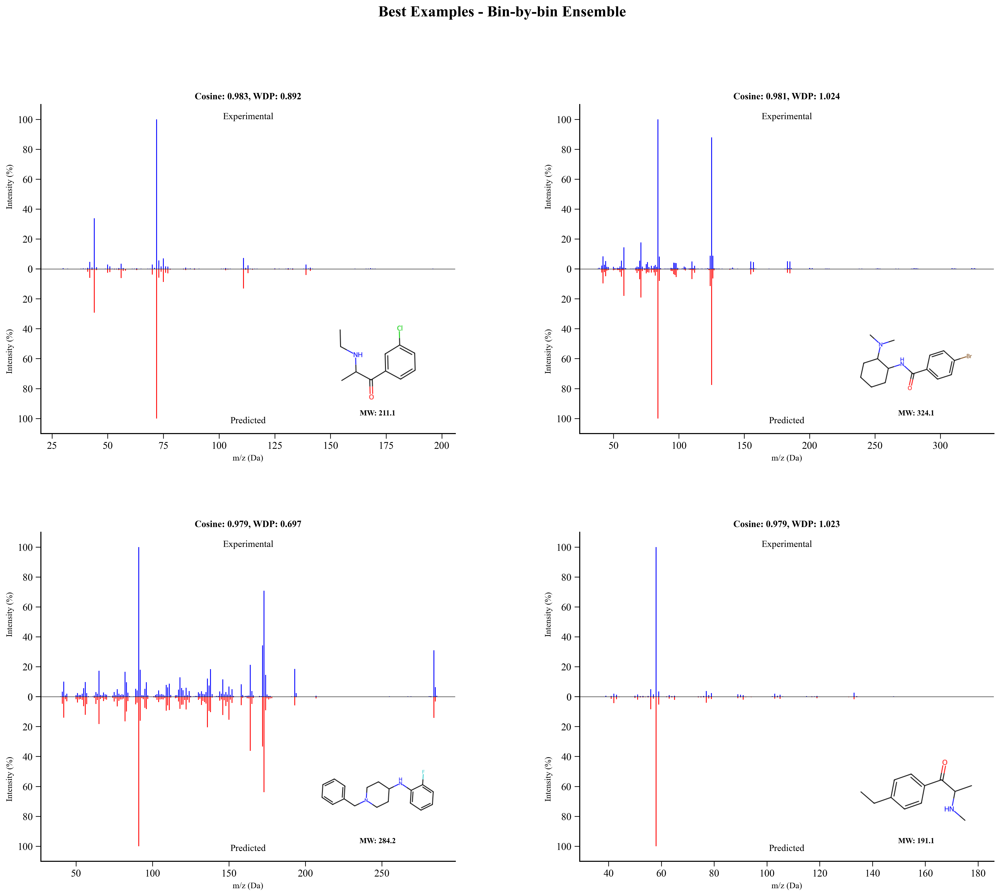


Creating individual detailed plots...


<Figure size 1920x1440 with 0 Axes>

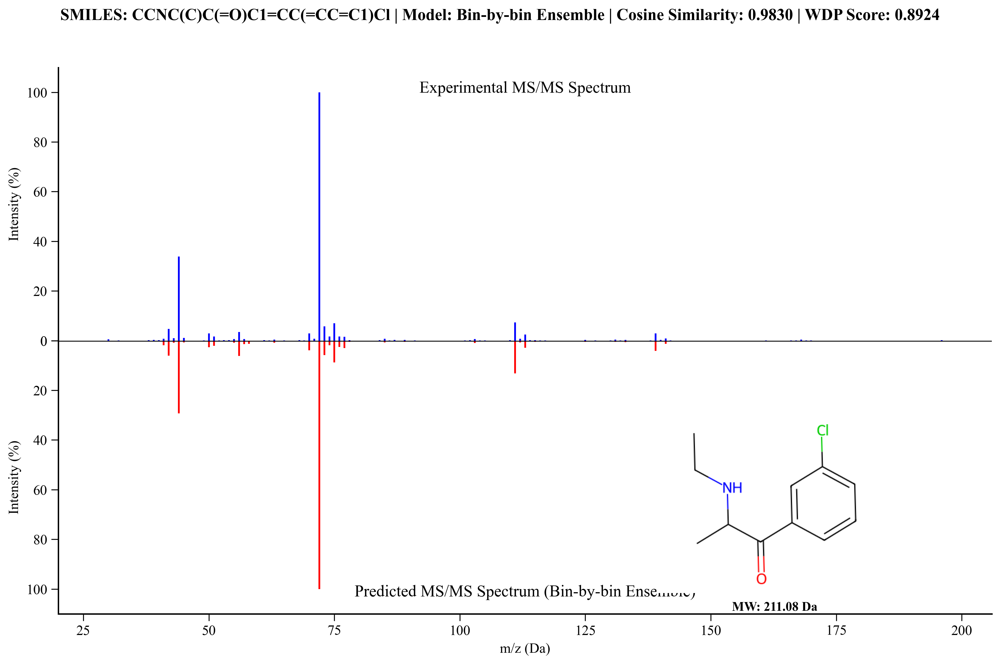

<Figure size 1920x1440 with 0 Axes>

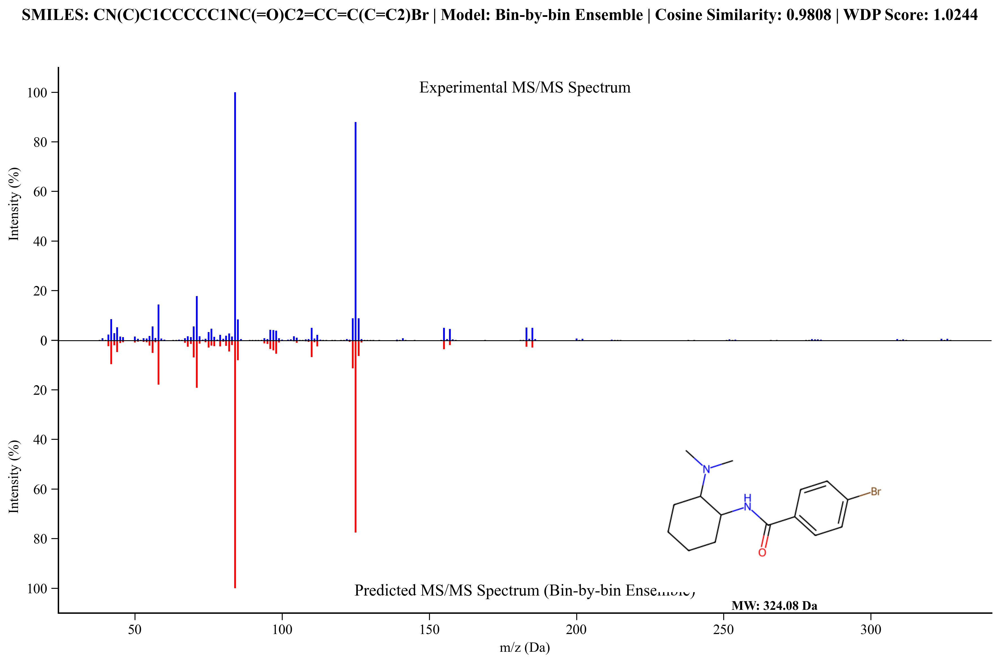


Creating worst example gallery for Bin-by-bin Ensemble...
Selected examples:
  1. Index 50: Cosine=0.3342, WDP=0.0805
  2. Index 81: Cosine=0.3432, WDP=0.2189
  3. Index 157: Cosine=0.3902, WDP=0.1288
  4. Index 122: Cosine=0.4416, WDP=0.1448


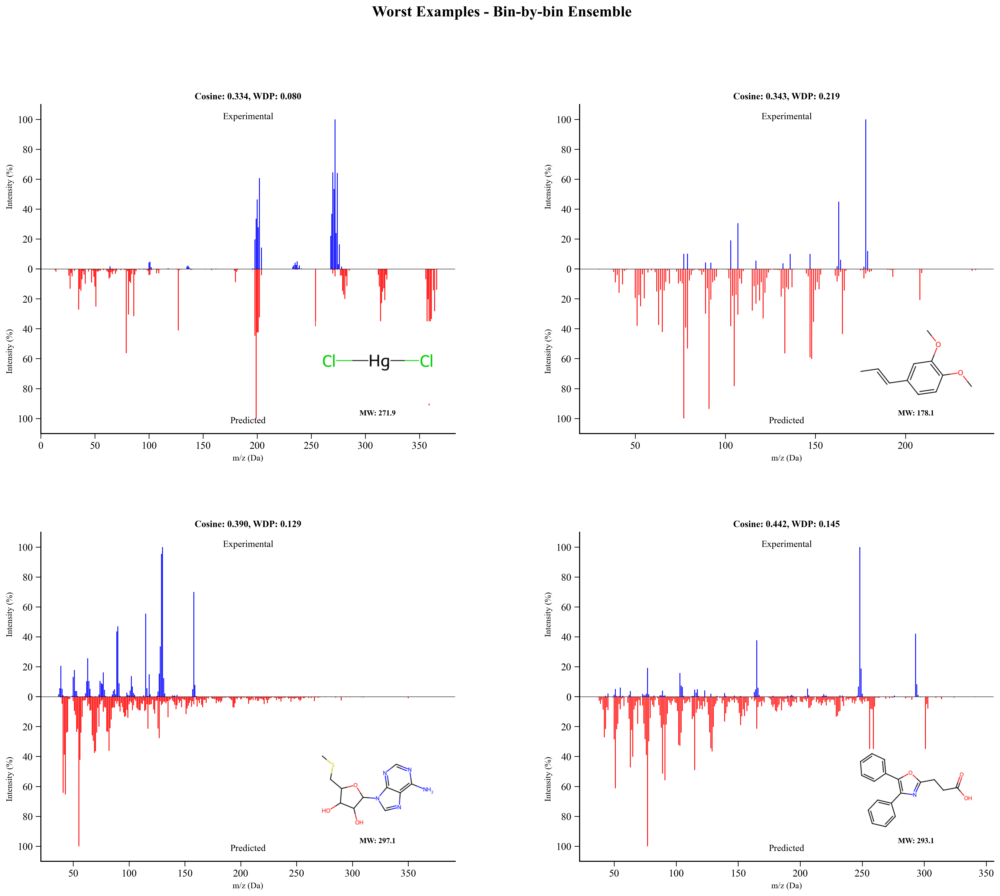


Creating diverse example gallery for Bin-by-bin Ensemble...
Selected examples:
  1. Index 192: Cosine=0.9830, WDP=0.8924
  2. Index 217: Cosine=0.8514, WDP=0.5109
  3. Index 81: Cosine=0.3432, WDP=0.2189
  4. Index 50: Cosine=0.3342, WDP=0.0805


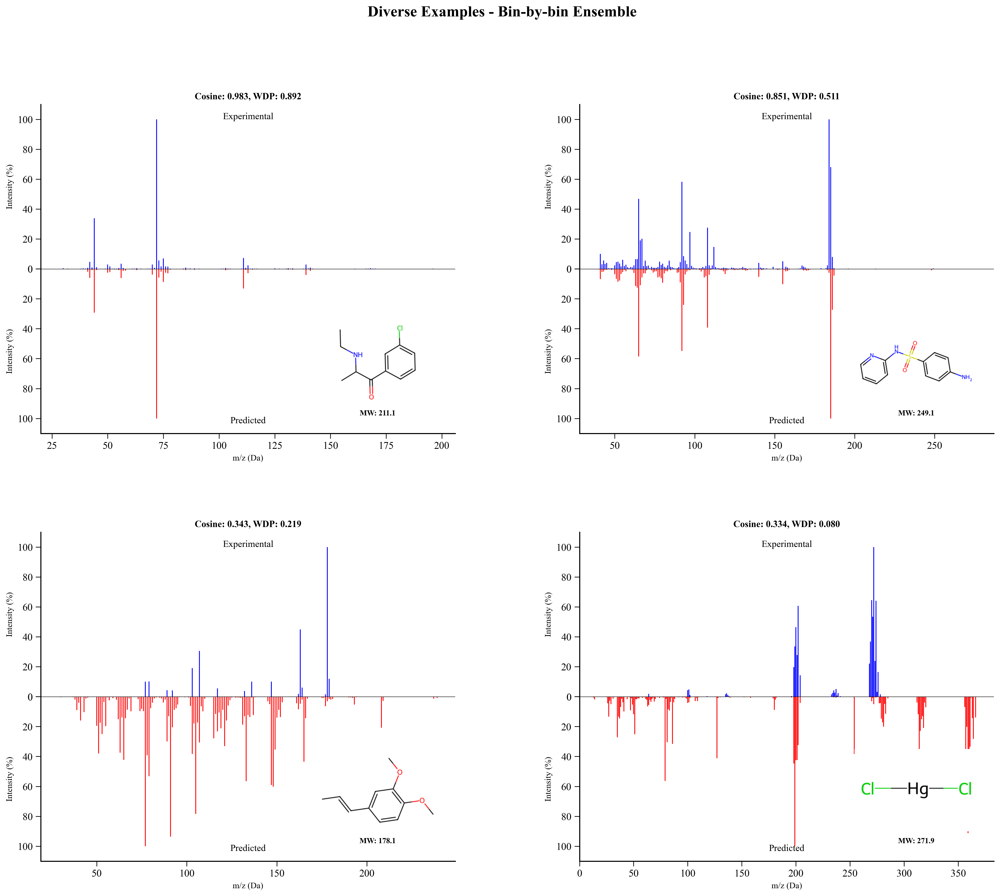


Creating comparison gallery for worst model: KNN

Creating diverse example gallery for KNN...
Selected examples:
  1. Index 82: Cosine=0.9732, WDP=0.9103
  2. Index 32: Cosine=0.7485, WDP=0.6913
  3. Index 140: Cosine=0.2441, WDP=0.0628
  4. Index 50: Cosine=0.2052, WDP=0.0767


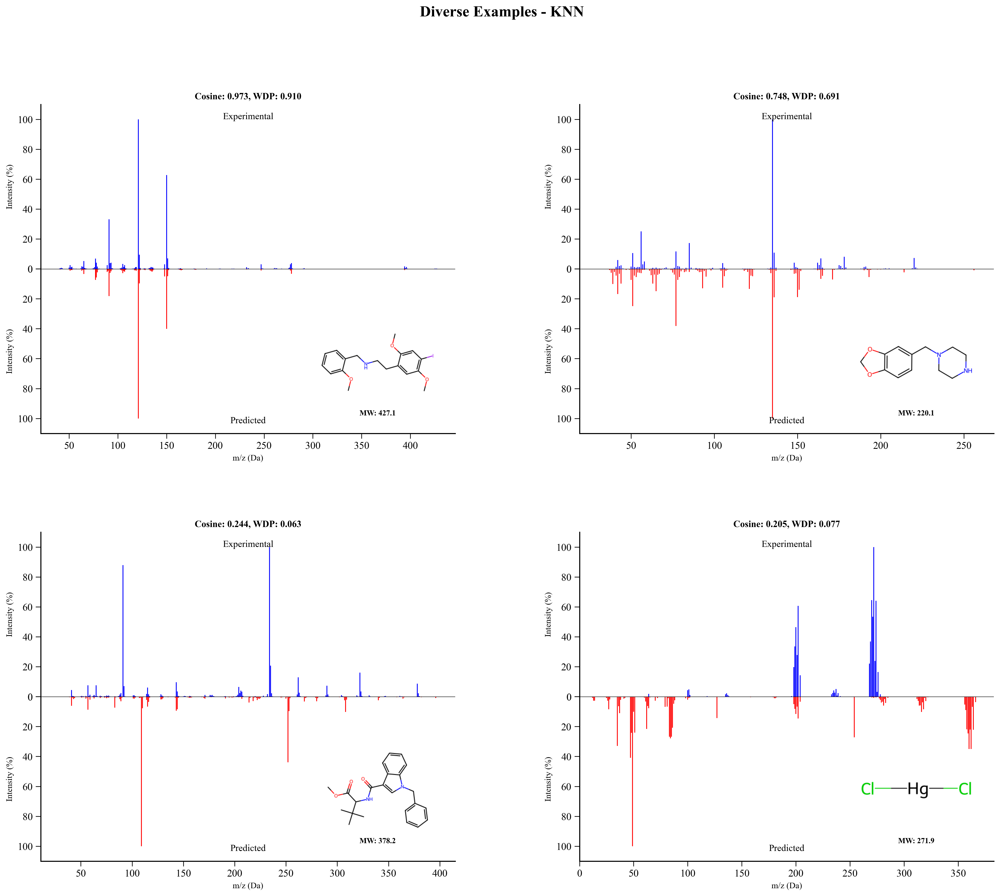


Spectrum galleries created successfully!


In [12]:
class SpectrumExampleSelector:
    """Select diverse examples for spectrum visualization."""
    
    def __init__(self, similarity_results: Dict[str, Dict], diagnostic_data: Dict[str, Any]):
        self.similarity_results = similarity_results
        self.diagnostic_data = diagnostic_data
        self.calc = SpectralSimilarityCalculator(transform_sqrt=DIAG_CONFIG['evaluation']['transform_sqrt'])
    
    def select_examples(self, model_name: str, selection_type: str = 'diverse', 
                       n_examples: int = 4) -> List[Tuple[int, float, float]]:
        """Select examples based on specified criteria."""
        
        cosine_similarities = self.similarity_results[model_name]['cosine_similarities']
        wdp_scores = self.similarity_results[model_name]['wdp_scores']
        
        examples = [(i, cosine_similarities[i], wdp_scores[i]) 
                   for i in range(len(cosine_similarities))]
        
        if selection_type == 'best':
            examples.sort(key=lambda x: x[1], reverse=True)
            return examples[:n_examples]
        
        elif selection_type == 'worst':
            examples.sort(key=lambda x: x[1])
            return examples[:n_examples]
        
        elif selection_type == 'diverse':
            examples.sort(key=lambda x: x[1], reverse=True)
            n_per_level = max(1, n_examples // 3)
            
            selected = []
            # Best examples
            selected.extend(examples[:n_per_level])
            # Middle examples
            mid_start = len(examples) // 2 - n_per_level // 2
            selected.extend(examples[mid_start:mid_start + n_per_level])
            # Worst examples
            selected.extend(examples[-(n_examples - len(selected)):])
            
            return selected[:n_examples]
        
        else:  # random
            random.shuffle(examples)
            return examples[:n_examples]
    
    def create_example_gallery(self, model_name: str, selection_type: str = 'diverse', 
                              n_examples: int = 4, save_individual: bool = True) -> None:
        """Create comprehensive example gallery."""
        
        print(f"\nCreating {selection_type} example gallery for {model_name}...")
        
        selected_examples = self.select_examples(model_name, selection_type, n_examples)
        
        y_test = self.diagnostic_data['y_test']
        predictions = self.diagnostic_data['predictions'][model_name]
        test_smiles = self.diagnostic_data['test_smiles']
        
        y_true_list = []
        y_pred_list = []
        smiles_list = []
        cosine_sims = []
        wdp_scores = []
        
        print(f"Selected examples:")
        for i, (idx, cosine_sim, wdp_score) in enumerate(selected_examples):
            y_true_list.append(y_test[idx])
            y_pred_list.append(predictions[idx])
            smiles_list.append(test_smiles[idx] if idx < len(test_smiles) else 'N/A')
            cosine_sims.append(cosine_sim)
            wdp_scores.append(wdp_score)
            
            print(f"  {i+1}. Index {idx}: Cosine={cosine_sim:.4f}, WDP={wdp_score:.4f}")
        
        # Create grid visualization
        if len(y_true_list) >= 4:
            fig = create_compact_spectrum_grid(y_true_list[:4], y_pred_list[:4], 
                                             smiles_list[:4], cosine_sims[:4], wdp_scores[:4],
                                             model_name=model_name, selection_type=selection_type.title())
            
            save_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 
                                    f'spectrum_grid_{model_name.replace(" ", "_")}_{selection_type}.png')
            fig.savefig(save_path, dpi=300, bbox_inches='tight')
            plt.show()
        
        # Create individual detailed plots if requested
        if save_individual and len(selected_examples) > 0:
            print(f"\nCreating individual detailed plots...")
            for i, (idx, cosine_sim, wdp_score) in enumerate(selected_examples[:2]):  # Limit to 2 for brevity
                smiles = test_smiles[idx] if idx < len(test_smiles) else 'N/A'
                
                plt.figure()
                visualize_spectrum_comparison(
                    y_test[idx], 
                    predictions[idx],
                    smiles,
                    cosine_sim=cosine_sim,
                    wdp_score=wdp_score,
                    mol_structure=True,
                    model_name=model_name
                )
                
                save_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 
                                        f'spectrum_{model_name.replace(" ", "_")}_{selection_type}_{i+1}.png')
                plt.savefig(save_path, dpi=300, bbox_inches='tight')
                plt.close()

# Create example galleries for best and worst models
example_selector = SpectrumExampleSelector(similarity_results, diagnostic_data)

print("Creating comprehensive spectrum galleries...")
print("=" * 60)

# Find best performing model
best_model_name = max(similarity_results.keys(), 
                     key=lambda x: similarity_results[x]['summary']['mean_cosine'])

# Create galleries for best performing model
selection_types = ['best', 'worst', 'diverse']

for selection_type in selection_types:
    try:
        example_selector.create_example_gallery(
            best_model_name, 
            selection_type=selection_type, 
            n_examples=4, 
            save_individual=(selection_type == 'best')  # Only save individual for best examples
        )
    except Exception as e:
        print(f"Error creating {selection_type} gallery for {best_model_name}: {e}")
        continue

# Also create gallery for worst performing model for comparison
worst_model_name = min(similarity_results.keys(), 
                      key=lambda x: similarity_results[x]['summary']['mean_cosine'])

if worst_model_name != best_model_name:
    print(f"\nCreating comparison gallery for worst model: {worst_model_name}")
    example_selector.create_example_gallery(
        worst_model_name, 
        selection_type='diverse', 
        n_examples=4, 
        save_individual=False
    )

print("\nSpectrum galleries created successfully!")

## 13. Advanced Diagnostic Insights

Analysis of failure modes, chemical space correlation, and model specialization for all 8 models.


Analyzing failure modes for all 8 models...


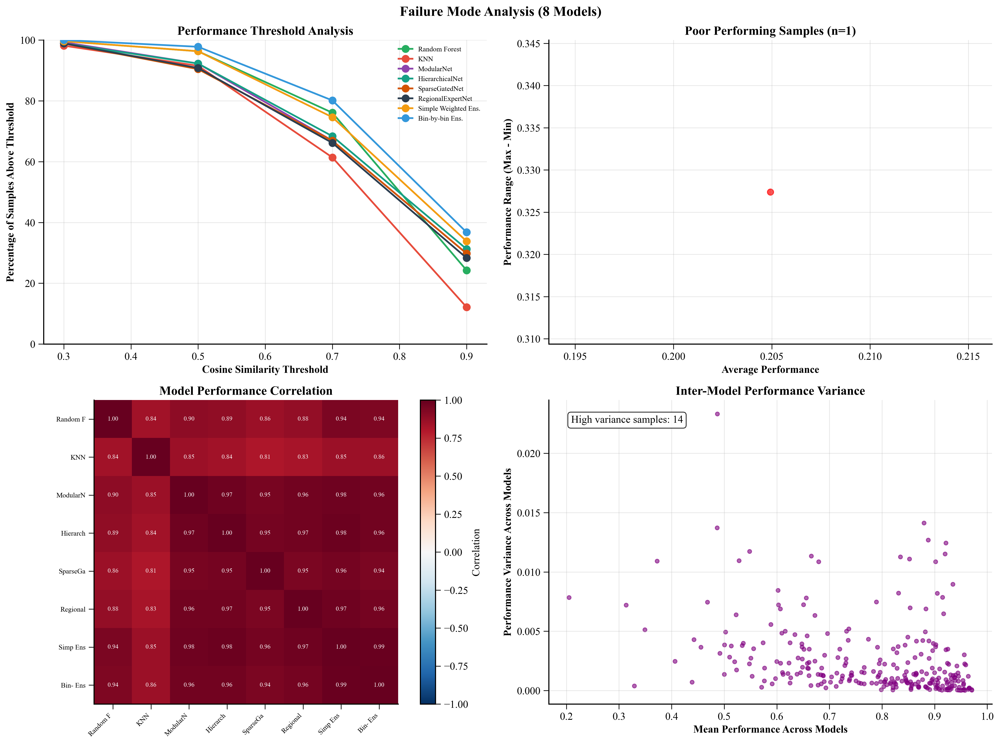


Failure Mode Summary (All 8 Models):
Random Forest: 1 poor samples (0.4%)
KNN: 5 poor samples (1.8%)
ModularNet: 2 poor samples (0.7%)
HierarchicalPredictionNet: 3 poor samples (1.1%)
SparseGatedNet: 3 poor samples (1.1%)
RegionalExpertNet: 3 poor samples (1.1%)
Simple Weighted Ensemble: 1 poor samples (0.4%)
Bin-by-bin Ensemble: 0 poor samples (0.0%)

Model Complementarity Analysis:
High correlation pairs (r > 0.9):
  Random Forest - Simple Weighted Ensemble: r = 0.941
  Random Forest - Bin-by-bin Ensemble: r = 0.936
  ModularNet - HierarchicalPredictionNet: r = 0.974
  ModularNet - SparseGatedNet: r = 0.950
  ModularNet - RegionalExpertNet: r = 0.962
  ModularNet - Simple Weighted Ensemble: r = 0.976
  ModularNet - Bin-by-bin Ensemble: r = 0.964
  HierarchicalPredictionNet - SparseGatedNet: r = 0.954
  HierarchicalPredictionNet - RegionalExpertNet: r = 0.968
  HierarchicalPredictionNet - Simple Weighted Ensemble: r = 0.979
  HierarchicalPredictionNet - Bin-by-bin Ensemble: r = 0.964

In [13]:
class AdvancedDiagnosticAnalyzer:
    """Advanced diagnostic analysis for understanding model behavior."""
    
    def __init__(self, similarity_results: Dict[str, Dict], diagnostic_data: Dict[str, Any]):
        self.similarity_results = similarity_results
        self.diagnostic_data = diagnostic_data
        self.calc = SpectralSimilarityCalculator(transform_sqrt=DIAG_CONFIG['evaluation']['transform_sqrt'])
    
    def analyze_failure_modes(self) -> None:
        """Analyze systematic failure patterns across all 8 models."""
        
        print("\nAnalyzing failure modes for all 8 models...")
        
        # Define performance thresholds
        thresholds = [0.3, 0.5, 0.7, 0.9]
        
        # Create failure mode analysis
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        fig.suptitle('Failure Mode Analysis (8 Models)', fontsize=16, fontweight='bold')
        
        # Plot 1: Performance threshold analysis (top left)
        ax1 = axes[0, 0]
        for model_name in self.similarity_results.keys():
            cosines = self.similarity_results[model_name]['cosine_similarities']
            percentages = [np.mean(cosines >= thresh) * 100 for thresh in thresholds]
            
            color = MODEL_COLORS.get(model_name, '#95a5a6')
            label = model_name.replace('PredictionNet', 'Net').replace(' Ensemble', ' Ens.')
            ax1.plot(thresholds, percentages, 'o-', color=color, linewidth=2, 
                    markersize=8, label=label)
        
        ax1.set_xlabel('Cosine Similarity Threshold', fontweight='bold')
        ax1.set_ylabel('Percentage of Samples Above Threshold', fontweight='bold')
        ax1.set_title('Performance Threshold Analysis', fontweight='bold')
        ax1.legend(fontsize=8, loc='best')
        ax1.grid(True, alpha=0.3)
        ax1.set_ylim(0, 100)
        
        # Plot 2: Low performance sample analysis (top right)
        ax2 = axes[0, 1]
        
        # Find consistently poor performing samples
        poor_threshold = 0.3
        poor_samples_data = []
        
        for i in range(len(self.diagnostic_data['y_test'])):
            model_performances = [self.similarity_results[model]['cosine_similarities'][i] 
                                for model in self.similarity_results.keys()]
            avg_performance = np.mean(model_performances)
            min_performance = np.min(model_performances)
            max_performance = np.max(model_performances)
            
            if avg_performance < poor_threshold:
                poor_samples_data.append({
                    'index': i,
                    'avg_performance': avg_performance,
                    'min_performance': min_performance,
                    'max_performance': max_performance,
                    'performance_range': max_performance - min_performance
                })
        
        if poor_samples_data:
            avg_perfs = [p['avg_performance'] for p in poor_samples_data]
            ranges = [p['performance_range'] for p in poor_samples_data]
            
            ax2.scatter(avg_perfs, ranges, alpha=0.7, s=50, color='red')
            ax2.set_xlabel('Average Performance', fontweight='bold')
            ax2.set_ylabel('Performance Range (Max - Min)', fontweight='bold')
            ax2.set_title(f'Poor Performing Samples (n={len(poor_samples_data)})', fontweight='bold')
            ax2.grid(True, alpha=0.3)
        else:
            ax2.text(0.5, 0.5, 'No consistently poor\nperforming samples found', 
                    ha='center', va='center', transform=ax2.transAxes, fontsize=14)
            ax2.set_title('Poor Performing Samples', fontweight='bold')
        
        # Plot 3: Model agreement analysis (bottom left)
        ax3 = axes[1, 0]
        
        # Calculate pairwise correlations between models
        model_names = list(self.similarity_results.keys())
        correlation_matrix = np.zeros((len(model_names), len(model_names)))
        
        for i, model1 in enumerate(model_names):
            for j, model2 in enumerate(model_names):
                cosines1 = self.similarity_results[model1]['cosine_similarities']
                cosines2 = self.similarity_results[model2]['cosine_similarities']
                correlation_matrix[i, j] = np.corrcoef(cosines1, cosines2)[0, 1]
        
        im = ax3.imshow(correlation_matrix, cmap='RdBu_r', vmin=-1, vmax=1)
        ax3.set_xticks(range(len(model_names)))
        ax3.set_yticks(range(len(model_names)))
        
        # Create shorter labels
        short_names = []
        for name in model_names:
            if 'Ensemble' in name:
                short_names.append(name.split()[0][:4] + ' Ens')
            elif len(name) > 8:
                short_names.append(name[:8])
            else:
                short_names.append(name)
        
        ax3.set_xticklabels(short_names, rotation=45, ha='right', fontsize=8)
        ax3.set_yticklabels(short_names, fontsize=8)
        
        # Add correlation values if not too many models
        for i in range(len(model_names)):
            for j in range(len(model_names)):
                text = ax3.text(j, i, f'{correlation_matrix[i, j]:.2f}',
                               ha="center", va="center", fontsize=7,
                               color="white" if abs(correlation_matrix[i, j]) > 0.5 else "black")
        
        ax3.set_title('Model Performance Correlation', fontweight='bold')
        plt.colorbar(im, ax=ax3, label='Correlation')
        
        # Plot 4: Performance variance analysis (bottom right)
        ax4 = axes[1, 1]
        
        # Calculate performance variance for each sample
        sample_variances = []
        sample_means = []
        
        for i in range(len(self.diagnostic_data['y_test'])):
            model_performances = [self.similarity_results[model]['cosine_similarities'][i] 
                                for model in self.similarity_results.keys()]
            sample_variances.append(np.var(model_performances))
            sample_means.append(np.mean(model_performances))
        
        ax4.scatter(sample_means, sample_variances, alpha=0.6, s=20, color='purple')
        ax4.set_xlabel('Mean Performance Across Models', fontweight='bold')
        ax4.set_ylabel('Performance Variance Across Models', fontweight='bold')
        ax4.set_title('Inter-Model Performance Variance', fontweight='bold')
        ax4.grid(True, alpha=0.3)
        
        # Add annotations
        high_variance_threshold = np.percentile(sample_variances, 95)
        high_variance_count = np.sum(np.array(sample_variances) > high_variance_threshold)
        ax4.text(0.05, 0.95, f'High variance samples: {high_variance_count}', 
                transform=ax4.transAxes, va='top',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        save_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 'failure_mode_analysis_8models.png')
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.show()
        
        # Print failure mode summary
        print("\nFailure Mode Summary (All 8 Models):")
        print("=" * 60)
        for model_name in self.similarity_results.keys():
            cosines = self.similarity_results[model_name]['cosine_similarities']
            poor_count = np.sum(cosines < poor_threshold)
            poor_percentage = poor_count / len(cosines) * 100
            print(f"{model_name}: {poor_count} poor samples ({poor_percentage:.1f}%)")
        
        # Identify model complementarity
        print("\nModel Complementarity Analysis:")
        print("High correlation pairs (r > 0.9):")
        for i in range(len(model_names)):
            for j in range(i+1, len(model_names)):
                if correlation_matrix[i, j] > 0.9:
                    print(f"  {model_names[i]} - {model_names[j]}: r = {correlation_matrix[i, j]:.3f}")
        
        print("\nLow correlation pairs (r < 0.7):")
        for i in range(len(model_names)):
            for j in range(i+1, len(model_names)):
                if correlation_matrix[i, j] < 0.7:
                    print(f"  {model_names[i]} - {model_names[j]}: r = {correlation_matrix[i, j]:.3f}")

# Create advanced diagnostic analyzer
advanced_analyzer = AdvancedDiagnosticAnalyzer(similarity_results, diagnostic_data)

# Run failure mode analysis for all 8 models
advanced_analyzer.analyze_failure_modes()

print("\nAdvanced diagnostic analysis complete!")

## 14. Final Summary and Recommendations

Comprehensive summary of all 8 models' performance and deployment recommendations.

In [14]:
def generate_final_report(similarity_results: Dict[str, Dict], diagnostic_data: Dict[str, Any]) -> None:
    """Generate comprehensive final report for all 8 models."""
    
    print("\n" + "="*80)
    print("COMPREHENSIVE MODEL EVALUATION REPORT")
    print("Mass Spectrometry Prediction Models")
    print("="*80)
    
    # Sort models by performance
    model_names = list(similarity_results.keys())
    sorted_models = sorted(model_names, 
                          key=lambda x: similarity_results[x]['summary']['mean_cosine'], 
                          reverse=True)
    
    print("\n1. MODEL PERFORMANCE RANKING")
    print("-"*60)
    print(f"{'Rank':<6} {'Model':<35} {'Cosine Sim':<12} {'WDP':<12} {'Peak F1':<12}")
    print("-"*60)
    
    for i, model_name in enumerate(sorted_models, 1):
        summary = similarity_results[model_name]['summary']
        print(f"{i:<6} {model_name:<35} {summary['mean_cosine']:<12.4f} "
              f"{summary['mean_wdp']:<12.4f} {summary['mean_peak_f1']:<12.4f}")
    
    # Ensemble vs Individual comparison
    ensemble_models = [m for m in model_names if 'Ensemble' in m]
    individual_models = [m for m in model_names if 'Ensemble' not in m]
    
    print("\n2. ENSEMBLE VS INDIVIDUAL MODELS")
    print("-"*60)
    
    if ensemble_models and individual_models:
        # Best of each category
        best_ensemble = max(ensemble_models, 
                          key=lambda x: similarity_results[x]['summary']['mean_cosine'])
        best_individual = max(individual_models, 
                            key=lambda x: similarity_results[x]['summary']['mean_cosine'])
        
        ensemble_score = similarity_results[best_ensemble]['summary']['mean_cosine']
        individual_score = similarity_results[best_individual]['summary']['mean_cosine']
        
        print(f"Best Ensemble Model: {best_ensemble}")
        print(f"  Performance: {ensemble_score:.6f}")
        print(f"\nBest Individual Model: {best_individual}")
        print(f"  Performance: {individual_score:.6f}")
        print(f"\nEnsemble Advantage: {(ensemble_score - individual_score):.6f} "
              f"({(ensemble_score - individual_score)/individual_score * 100:.2f}% improvement)")
        
        # Average performance
        avg_ensemble = np.mean([similarity_results[m]['summary']['mean_cosine'] 
                               for m in ensemble_models])
        avg_individual = np.mean([similarity_results[m]['summary']['mean_cosine'] 
                                 for m in individual_models])
        
        print(f"\nAverage Ensemble Performance: {avg_ensemble:.6f}")
        print(f"Average Individual Performance: {avg_individual:.6f}")
    
    print("\n3. DEPLOYMENT RECOMMENDATIONS")
    print("-"*60)
    
    best_model = sorted_models[0]
    best_score = similarity_results[best_model]['summary']['mean_cosine']
    
    print(f"✓ RECOMMENDED FOR PRODUCTION: {best_model}")
    print(f"  - Mean Cosine Similarity: {best_score:.6f}")
    print(f"  - 95th Percentile: {similarity_results[best_model]['summary']['percentile_95']:.4f}")
    print(f"  - 5th Percentile: {similarity_results[best_model]['summary']['percentile_5']:.4f}")
    
    if best_score >= 0.8:
        print("\n  QUALITY ASSESSMENT: EXCELLENT")
        print("  Model achieves high accuracy suitable for production use.")
    elif best_score >= 0.7:
        print("\n  QUALITY ASSESSMENT: GOOD")
        print("  Model shows good performance with room for improvement.")
    elif best_score >= 0.6:
        print("\n  QUALITY ASSESSMENT: MODERATE")
        print("  Model may benefit from additional training or architecture changes.")
    else:
        print("\n  QUALITY ASSESSMENT: NEEDS IMPROVEMENT")
        print("  Consider retraining with more data or alternative approaches.")
    
    print("\n4. MODEL CHARACTERISTICS")
    print("-"*60)
    
    # Analyze model types
    ml_models = ['Random Forest', 'KNN']
    nn_models = ['ModularNet', 'HierarchicalPredictionNet', 'SparseGatedNet', 'RegionalExpertNet']
    
    ml_scores = [similarity_results[m]['summary']['mean_cosine'] 
                for m in ml_models if m in similarity_results]
    nn_scores = [similarity_results[m]['summary']['mean_cosine'] 
                for m in nn_models if m in similarity_results]
    
    if ml_scores:
        print(f"Traditional ML Models (n={len(ml_scores)}):")
        print(f"  Mean Performance: {np.mean(ml_scores):.6f}")
        print(f"  Best: {max(ml_scores):.6f}")
    
    if nn_scores:
        print(f"\nNeural Network Models (n={len(nn_scores)}):")
        print(f"  Mean Performance: {np.mean(nn_scores):.6f}")
        print(f"  Best: {max(nn_scores):.6f}")
    
    print("\n5. FUTURE IMPROVEMENTS")
    print("-"*60)
    
    # Analyze weaknesses
    worst_model = sorted_models[-1]
    worst_score = similarity_results[worst_model]['summary']['mean_cosine']
    performance_gap = best_score - worst_score
    
    print(f"Performance Gap (Best - Worst): {performance_gap:.6f}")
    
    if performance_gap > 0.1:
        print("✓ Large performance variation suggests potential for targeted improvements")
    
    # Check for high variance samples
    all_variances = []
    for i in range(len(diagnostic_data['y_test'])):
        performances = [similarity_results[m]['cosine_similarities'][i] for m in model_names]
        all_variances.append(np.var(performances))
    
    high_var_count = np.sum(np.array(all_variances) > np.percentile(all_variances, 95))
    
    print(f"\nSamples with high inter-model variance: {high_var_count}")
    if high_var_count > len(diagnostic_data['y_test']) * 0.05:
        print("✓ Consider targeted training on high-variance samples")
    
    print("\nRecommended next steps:")
    print("1. Analyze failure modes of poorly predicted samples")
    print("2. Consider data augmentation for underrepresented chemical spaces")
    print("3. Experiment with model-specific hyperparameter tuning")
    if 'Ensemble' not in best_model:
        print("4. Create optimized ensemble combining top performers")
    
    print("\n" + "="*80)
    print("END OF REPORT")
    print("="*80)

# Generate final report
generate_final_report(similarity_results, diagnostic_data)

# Save summary statistics
summary_stats = {}
for model_name, results in similarity_results.items():
    summary_stats[model_name] = results['summary']

summary_path = os.path.join(DIAG_CONFIG['paths']['figures_dir'], 'model_summary_statistics.json')
with open(summary_path, 'w') as f:
    json.dump(summary_stats, f, indent=2, default=lambda x: float(x) if isinstance(x, np.floating) else x)

print(f"\nSummary statistics saved to: {summary_path}")
print(f"All diagnostic figures saved to: {DIAG_CONFIG['paths']['figures_dir']}")
print("\n" + "="*60)
print("COMPREHENSIVE DIAGNOSTIC ANALYSIS COMPLETE!")
print("="*60)


COMPREHENSIVE MODEL EVALUATION REPORT
Mass Spectrometry Prediction Models

1. MODEL PERFORMANCE RANKING
------------------------------------------------------------
Rank   Model                               Cosine Sim   WDP          Peak F1     
------------------------------------------------------------
1      Bin-by-bin Ensemble                 0.8164       0.5646       0.7477      
2      Simple Weighted Ensemble            0.8037       0.5482       0.7501      
3      Random Forest                       0.7837       0.4948       0.7057      
4      HierarchicalPredictionNet           0.7770       0.6288       0.7837      
5      ModularNet                          0.7691       0.5861       0.7798      
6      SparseGatedNet                      0.7674       0.5714       0.7707      
7      RegionalExpertNet                   0.7622       0.5818       0.7664      
8      KNN                                 0.7325       0.4838       0.7529      

2. ENSEMBLE VS INDIVIDUAL MODELS
-